# Notebook para preprocessamento de imagens para reconhecimento facial
# Felipe Meier Martins | 22100504

### Aquisição de fotos para benchmark

In [1]:
import cv2
import os
import time

def capturar_fotos_webcam(pasta_destino="fotos", num_fotos=10, intervalo_segundos=10):
    # Cria a pasta se ela não existir
    os.makedirs(pasta_destino, exist_ok=True)

    # Inicializa a webcam (0 = webcam padrão)
    cap = cv2.VideoCapture(1)

    if not cap.isOpened():
        print("Erro: não foi possível acessar a webcam.")
        return

    print("Captura iniciada. Olhe para a câmera...")

    for i in range(num_fotos):
        ret, frame = cap.read()
        if not ret:
            print(f"Erro ao capturar a imagem {i + 1}.")
            continue

        nome_arquivo = os.path.join(pasta_destino, f"foto_{i+1}.jpg")
        cv2.imwrite(nome_arquivo, frame)
        print(f"Foto {i+1} salva em: {nome_arquivo}")

        if i < num_fotos - 1:
            time.sleep(intervalo_segundos)

    cap.release()
    print("Captura finalizada.")


In [2]:
capturar_fotos_webcam("NEG16_NOITE", num_fotos=10, intervalo_segundos=1)

Erro: não foi possível acessar a webcam.


In [36]:
import matplotlib.pyplot as plt
def plotar_fotos(pasta="minhas_fotos", colunas=5, tamanho=(15, 10)):
    # Lista os arquivos de imagem
    arquivos = sorted([
        f for f in os.listdir(pasta)
        if f.lower().endswith(('.jpg', '.jpeg', '.png'))
    ])

    if not arquivos:
        print("Nenhuma imagem encontrada na pasta.")
        return

    total = len(arquivos)
    linhas = (total + colunas - 1) // colunas  # Arredondamento pra cima

    fig, axs = plt.subplots(linhas, colunas, figsize=tamanho)
    axs = axs.flatten()  # Facilita o acesso aos subplots

    for i, nome_arquivo in enumerate(arquivos):
        caminho = os.path.join(pasta, nome_arquivo)
        imagem = cv2.imread(caminho)
        imagem_rgb = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)
        escala = 0.3  # por exemplo, 30% do tamanho original
        imagem = cv2.resize(imagem, (0, 0), fx=escala, fy=escala)


        axs[i].imshow(imagem_rgb)
        axs[i].set_title(f"Foto {i+1}")
        axs[i].axis("off")

    # Desativar eixos extras se houver
    for j in range(i+1, len(axs)):
        axs[j].axis("off")

    plt.tight_layout()
    plt.show()

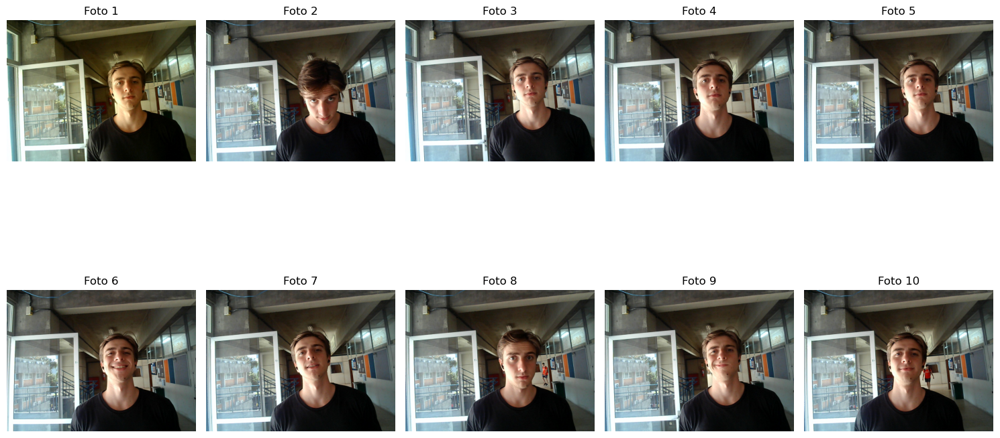

In [37]:
plotar_fotos("GUF_TARDE")

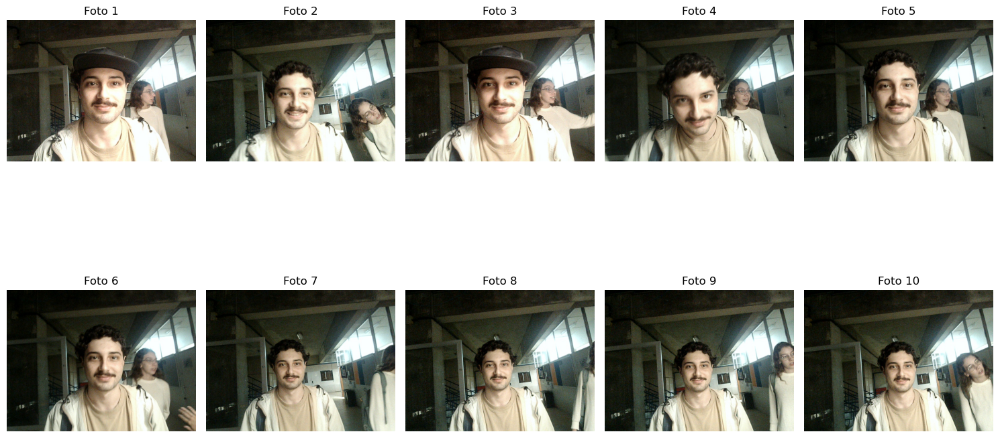

In [38]:
plotar_fotos("NEG15_NOITE")

O ideal aqui é testar com diferentes iluminações

### Benchmark de processamentos de imagens: Teste de diversas técnicas

Melhoraria de iluminação

Gamma correction - https://pyimagesearch.com/2015/10/05/opencv-gamma-correction/

In [5]:
import numpy as np
def gamma_correction(image, gamma=1.0):
    # Normaliza para [0, 1]
    normalized = image / 255.0
    # Aplica correção gama
    corrected = np.power(normalized, gamma)
    # Converte de volta para [0, 255]
    result = np.uint8(corrected * 255)
    return result

In [6]:
def definir_gamma(media_pixel):
    # Ajuste baseado na média da imagem
    if media_pixel < 80:
        return 0.4  # imagem muito escura, clarear bastante
    elif media_pixel < 120:
        return 0.7  # escura, clarear
    elif media_pixel < 140:
        return 1.0  # gamma neutro
    elif media_pixel < 180:
        return 1.3  # clara, escurecer um pouco
    else:
        return 1.6  # muito clara, escurecer mais

List comprehension para aplicar a correção gamma em cada imagem

In [23]:
pasta_entrada = 'NEG15_NOITE'
pasta_saida = 'correcao_gamma'
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        print('entrou')
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir a imagem {arquivo}, pulando.")
            continue

        media = np.mean(img)
        gamma = definir_gamma(media)

        img_corrigida = gamma_correction(img, gamma)

        # Converter para RGB antes de salvar
        img_rgb = cv2.cvtColor(img_corrigida, cv2.COLOR_GRAY2RGB)

        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_rgb)
        print(f"{arquivo}: média={media:.1f}, gamma={gamma} aplicado e salvo em {caminho_saida}")


entrou
foto_1.jpg: média=104.8, gamma=0.7 aplicado e salvo em correcao_gamma\foto_1.jpg
entrou
foto_10.jpg: média=101.5, gamma=0.7 aplicado e salvo em correcao_gamma\foto_10.jpg
entrou
foto_2.jpg: média=104.2, gamma=0.7 aplicado e salvo em correcao_gamma\foto_2.jpg
entrou
foto_3.jpg: média=88.2, gamma=0.7 aplicado e salvo em correcao_gamma\foto_3.jpg
entrou
foto_4.jpg: média=86.7, gamma=0.7 aplicado e salvo em correcao_gamma\foto_4.jpg
entrou
foto_5.jpg: média=82.9, gamma=0.7 aplicado e salvo em correcao_gamma\foto_5.jpg
entrou
foto_6.jpg: média=89.9, gamma=0.7 aplicado e salvo em correcao_gamma\foto_6.jpg
entrou
foto_7.jpg: média=91.0, gamma=0.7 aplicado e salvo em correcao_gamma\foto_7.jpg
entrou
foto_8.jpg: média=92.2, gamma=0.7 aplicado e salvo em correcao_gamma\foto_8.jpg
entrou
foto_9.jpg: média=94.2, gamma=0.7 aplicado e salvo em correcao_gamma\foto_9.jpg


In [24]:
pasta_entrada = 'NEG15_NOITE'
pasta_saida = 'teste_cinza'

os.makedirs(pasta_saida, exist_ok=True)

for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_entrada = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_entrada)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        
        # Converter para grayscale
        img_cinza = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
        # Salvar imagem em escala de cinza
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_cinza)
        print(f"{arquivo} convertida para cinza e salva em {caminho_saida}")

foto_1.jpg convertida para cinza e salva em teste_cinza\foto_1.jpg
foto_10.jpg convertida para cinza e salva em teste_cinza\foto_10.jpg
foto_2.jpg convertida para cinza e salva em teste_cinza\foto_2.jpg
foto_3.jpg convertida para cinza e salva em teste_cinza\foto_3.jpg
foto_4.jpg convertida para cinza e salva em teste_cinza\foto_4.jpg
foto_5.jpg convertida para cinza e salva em teste_cinza\foto_5.jpg
foto_6.jpg convertida para cinza e salva em teste_cinza\foto_6.jpg
foto_7.jpg convertida para cinza e salva em teste_cinza\foto_7.jpg
foto_8.jpg convertida para cinza e salva em teste_cinza\foto_8.jpg
foto_9.jpg convertida para cinza e salva em teste_cinza\foto_9.jpg


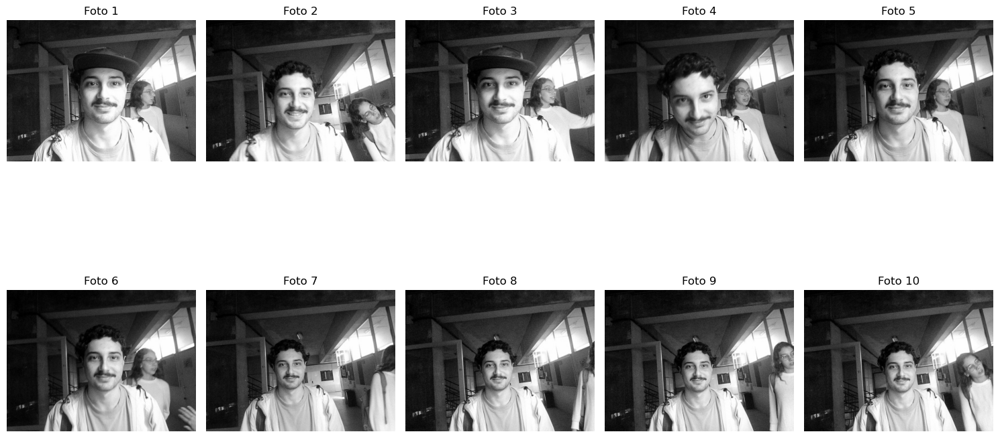

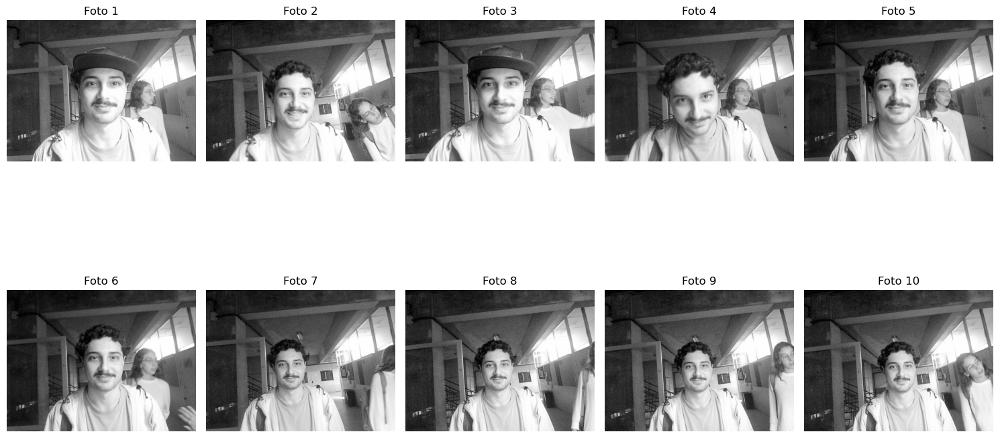

In [25]:
plotar_fotos("teste_cinza")
plotar_fotos("correcao_gamma")

Equalização de histograma - geral e localizado

Global

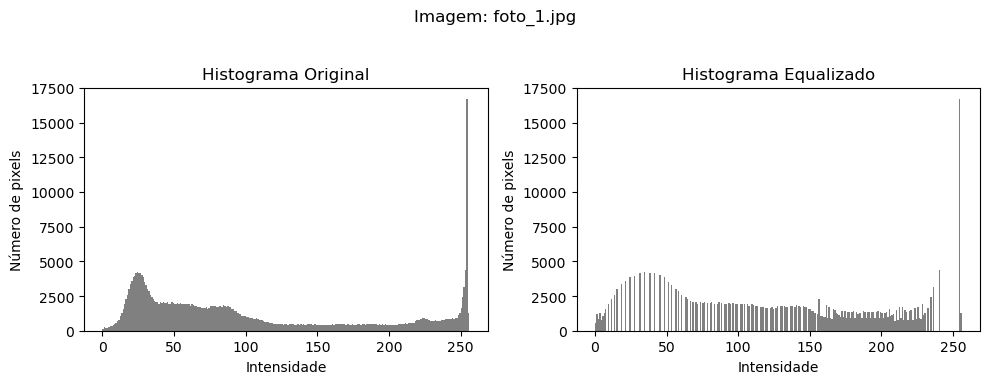

foto_1.jpg equalizada e salva em equalizacao_histograma\foto_1.jpg


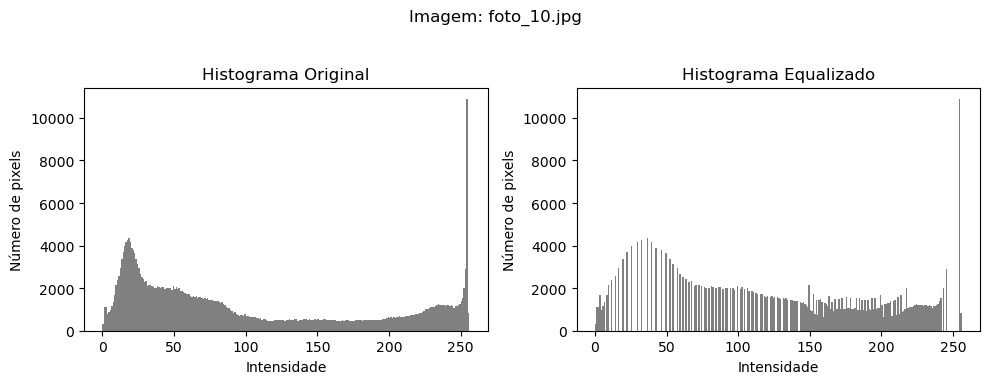

foto_10.jpg equalizada e salva em equalizacao_histograma\foto_10.jpg


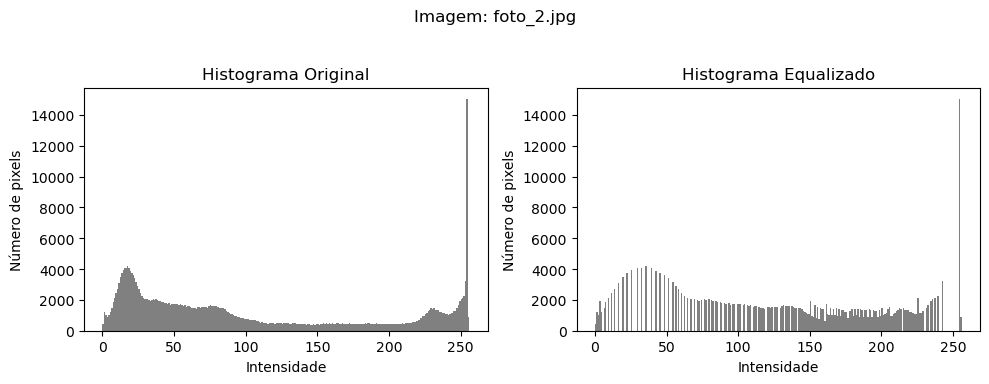

foto_2.jpg equalizada e salva em equalizacao_histograma\foto_2.jpg


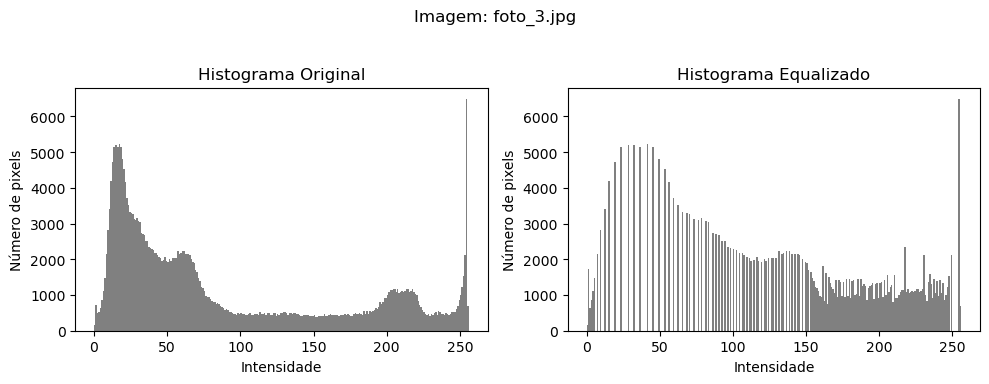

foto_3.jpg equalizada e salva em equalizacao_histograma\foto_3.jpg


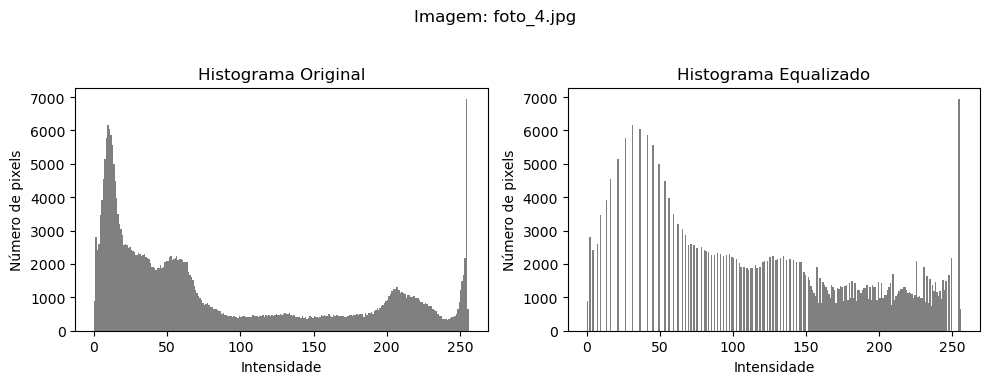

foto_4.jpg equalizada e salva em equalizacao_histograma\foto_4.jpg


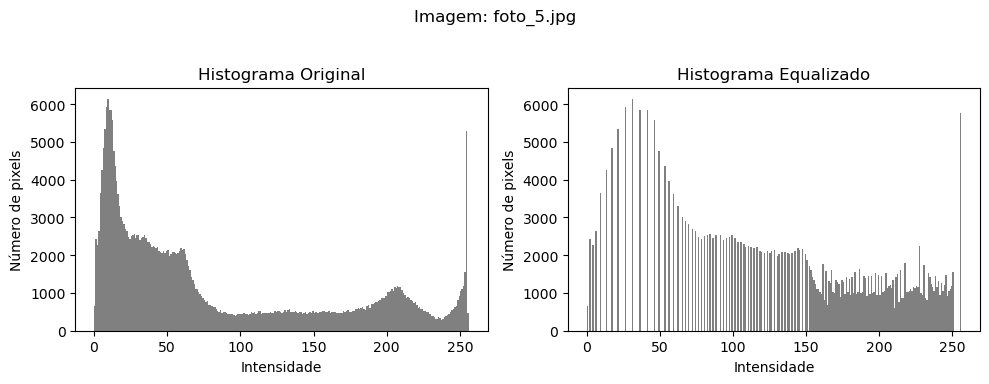

foto_5.jpg equalizada e salva em equalizacao_histograma\foto_5.jpg


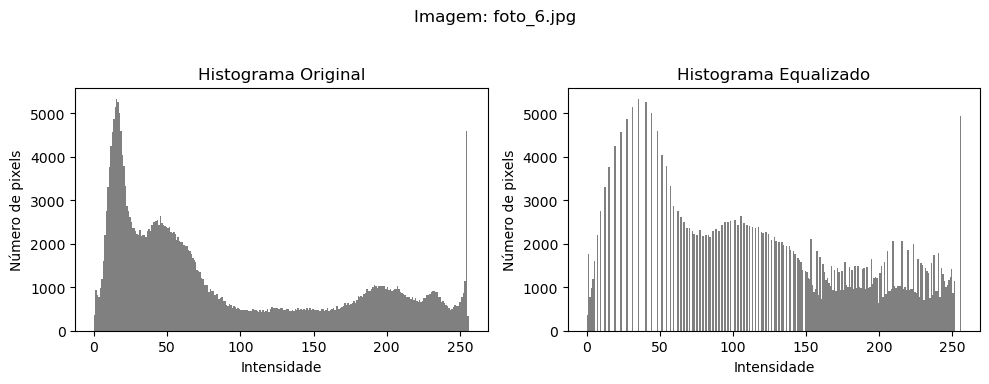

foto_6.jpg equalizada e salva em equalizacao_histograma\foto_6.jpg


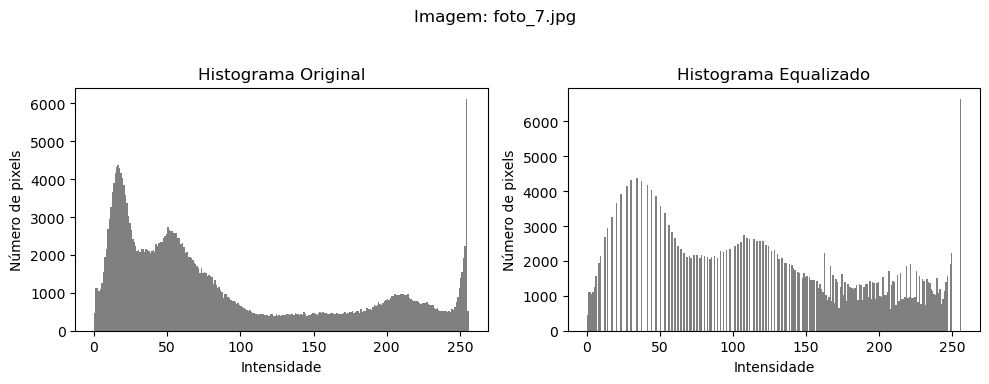

foto_7.jpg equalizada e salva em equalizacao_histograma\foto_7.jpg


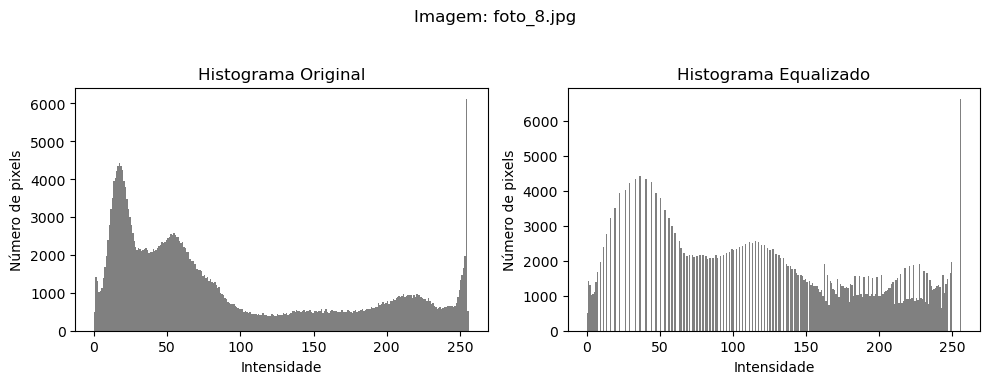

foto_8.jpg equalizada e salva em equalizacao_histograma\foto_8.jpg


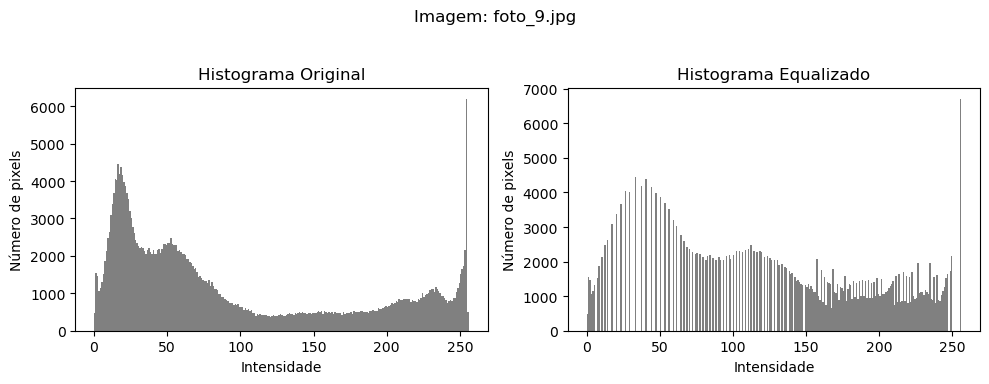

foto_9.jpg equalizada e salva em equalizacao_histograma\foto_9.jpg


In [26]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'equalizacao_histograma'

os.makedirs(pasta_saida, exist_ok=True)

for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        
        # Equalização global do histograma
        img_eq = cv2.equalizeHist(img)
        
        # Plotar histograma original e equalizado lado a lado
        plt.figure(figsize=(10,4))

        plt.subplot(1,2,1)
        plt.title('Histograma Original')
        plt.xlabel('Intensidade')
        plt.ylabel('Número de pixels')
        plt.hist(img.ravel(), bins=256, range=[0,256], color='gray')

        plt.subplot(1,2,2)
        plt.title('Histograma Equalizado')
        plt.xlabel('Intensidade')
        plt.ylabel('Número de pixels')
        plt.hist(img_eq.ravel(), bins=256, range=[0,256], color='gray')

        plt.suptitle(f'Imagem: {arquivo}')
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

        # Salvar imagem equalizada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_eq)
        print(f"{arquivo} equalizada e salva em {caminho_saida}")

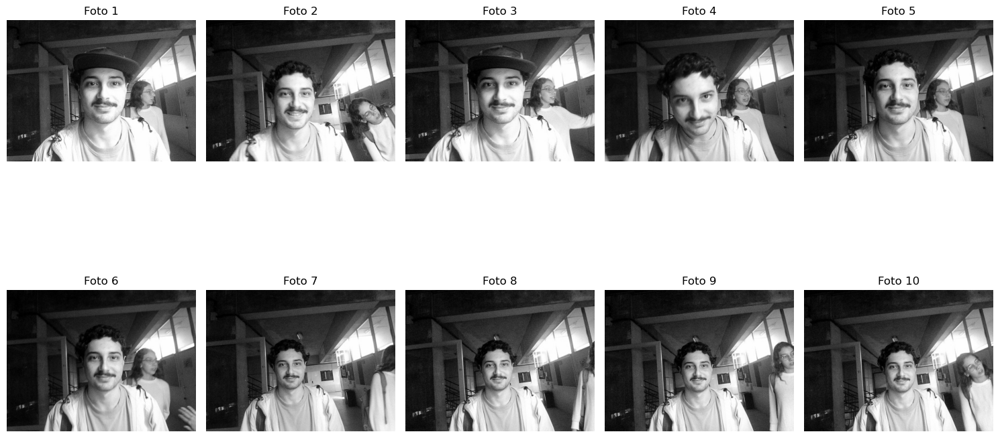

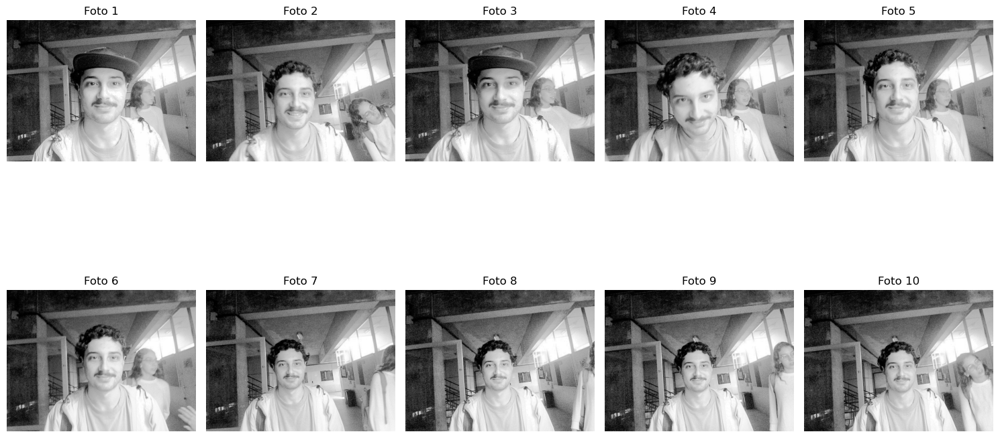

In [27]:
plotar_fotos("teste_cinza")
plotar_fotos("equalizacao_histograma")

Equalização geral piorou para fotos de noite

Localizado

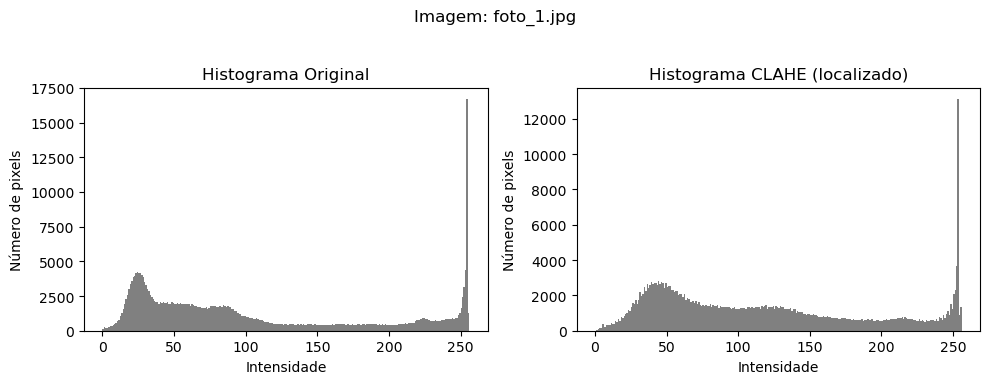

foto_1.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_1.jpg


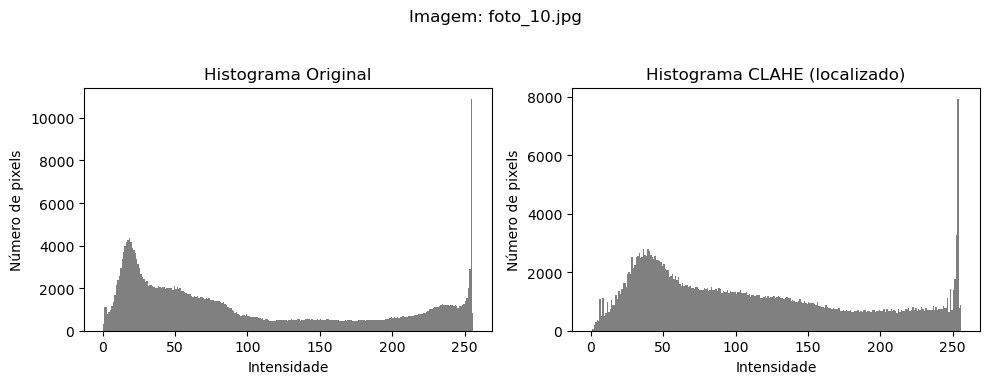

foto_10.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_10.jpg


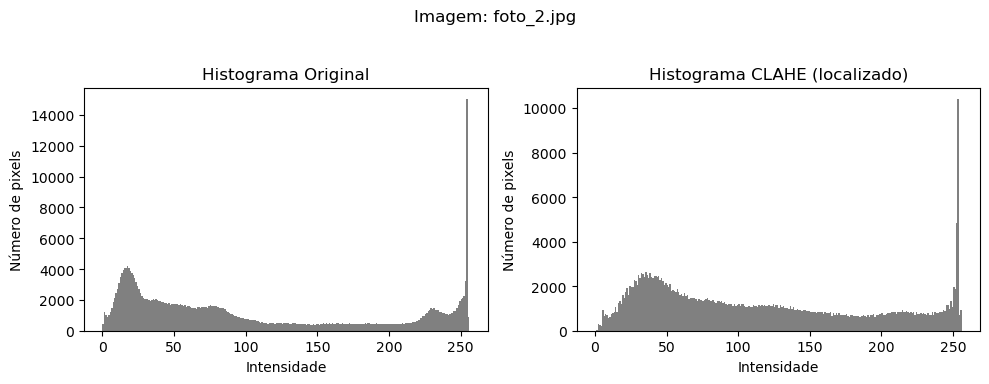

foto_2.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_2.jpg


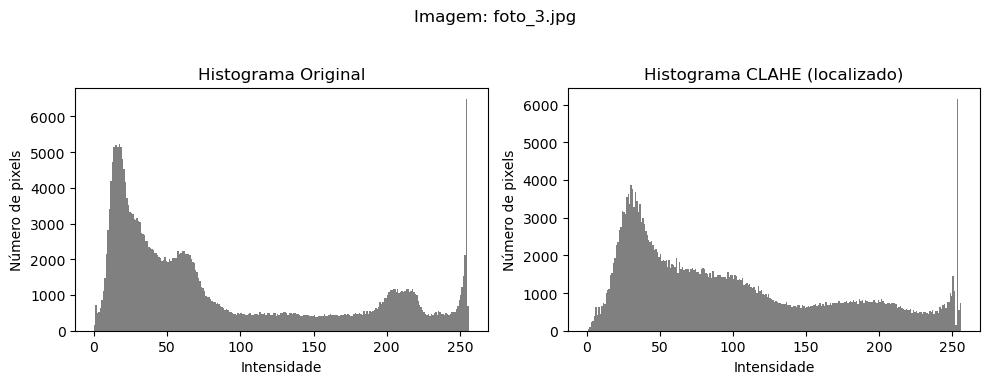

foto_3.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_3.jpg


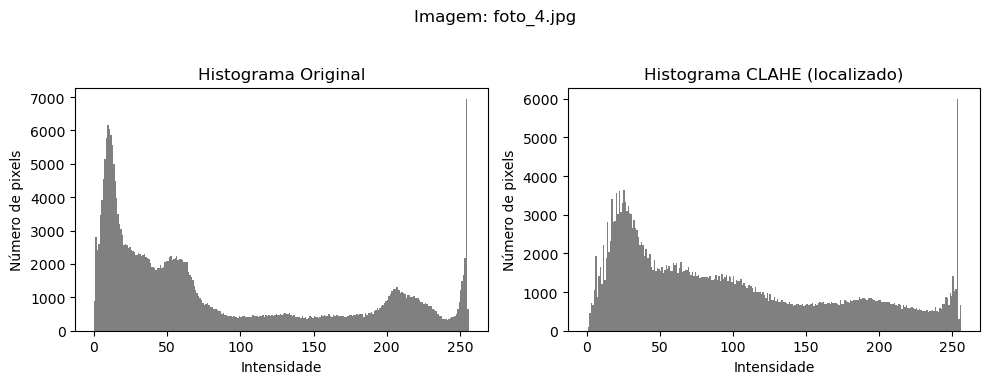

foto_4.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_4.jpg


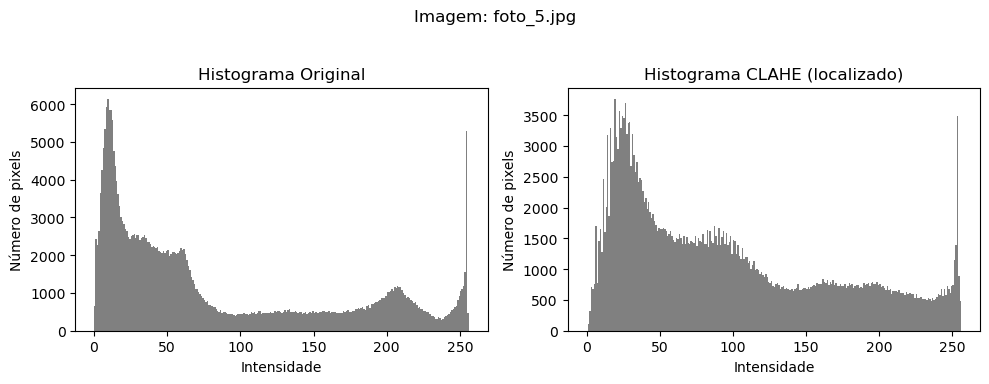

foto_5.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_5.jpg


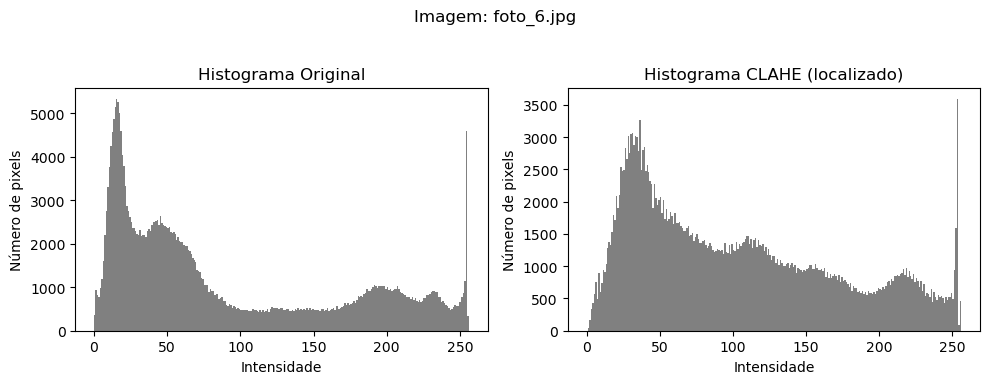

foto_6.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_6.jpg


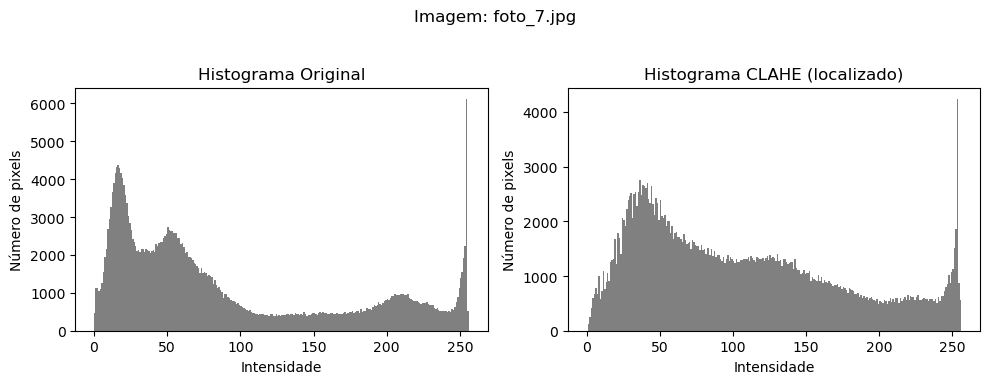

foto_7.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_7.jpg


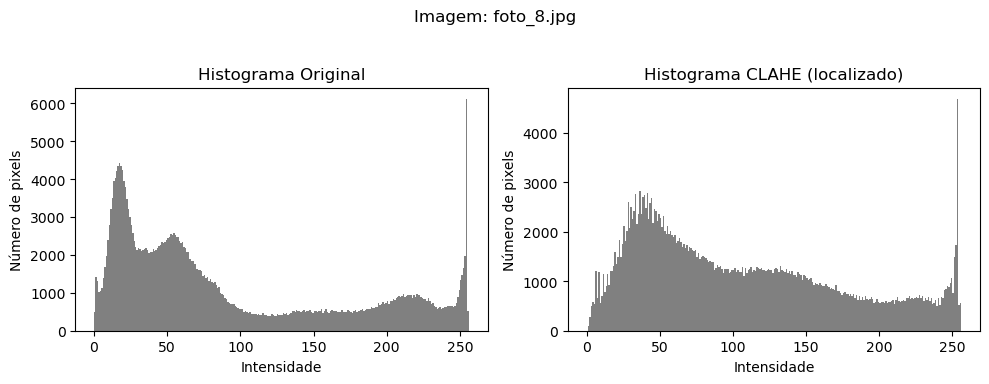

foto_8.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_8.jpg


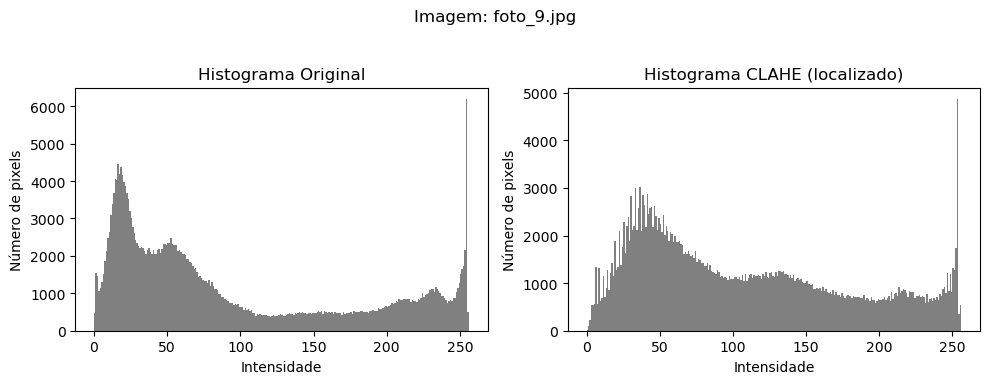

foto_9.jpg equalizada com CLAHE e salva em equalizacao_histograma_localizada\foto_9.jpg


In [28]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'equalizacao_histograma_localizada'

os.makedirs(pasta_saida, exist_ok=True)

# Criar objeto CLAHE (ajuste os parâmetros se quiser)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))

for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        
        # Aplicar CLAHE (equalização localizada)
        img_clahe = clahe.apply(img)
        
        # Plotar histograma original e equalizado lado a lado
        plt.figure(figsize=(10,4))

        plt.subplot(1,2,1)
        plt.title('Histograma Original')
        plt.xlabel('Intensidade')
        plt.ylabel('Número de pixels')
        plt.hist(img.ravel(), bins=256, range=[0,256], color='gray')

        plt.subplot(1,2,2)
        plt.title('Histograma CLAHE (localizado)')
        plt.xlabel('Intensidade')
        plt.ylabel('Número de pixels')
        plt.hist(img_clahe.ravel(), bins=256, range=[0,256], color='gray')

        plt.suptitle(f'Imagem: {arquivo}')
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

        # Salvar imagem CLAHE
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_clahe)
        print(f"{arquivo} equalizada com CLAHE e salva em {caminho_saida}")

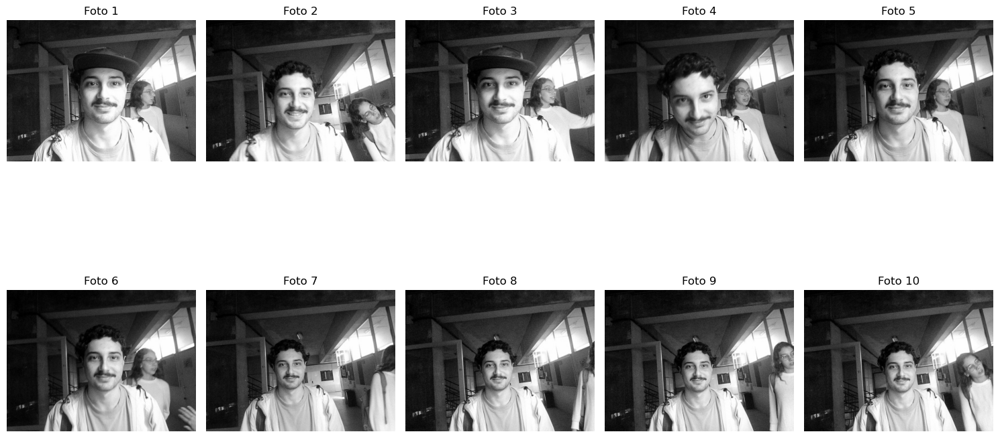

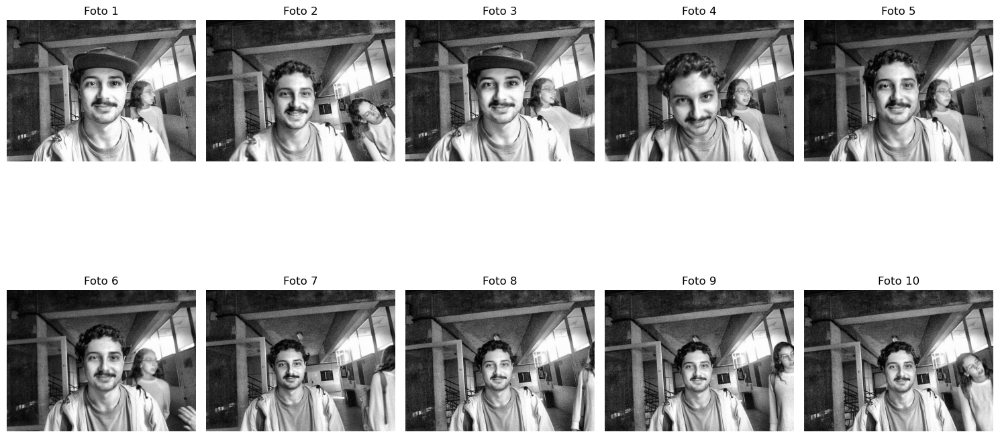

In [29]:
plotar_fotos("teste_cinza")
plotar_fotos("equalizacao_histograma_localizada")

Comparação das 3 técnicas

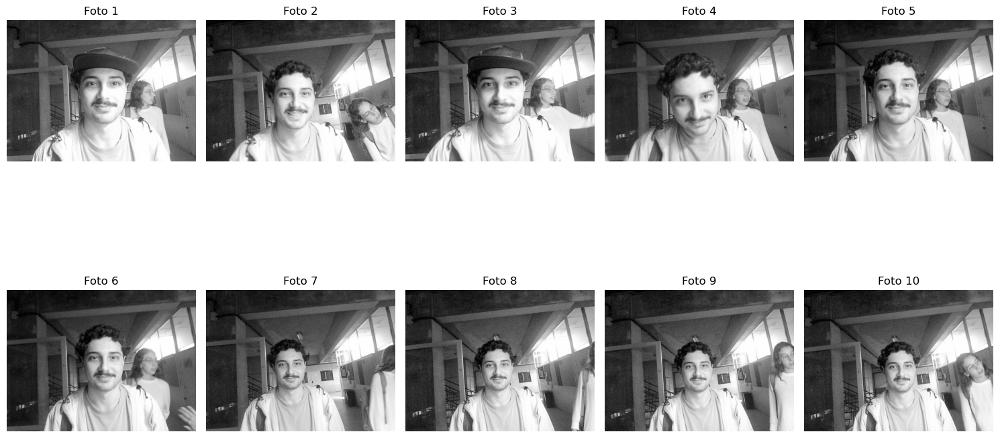

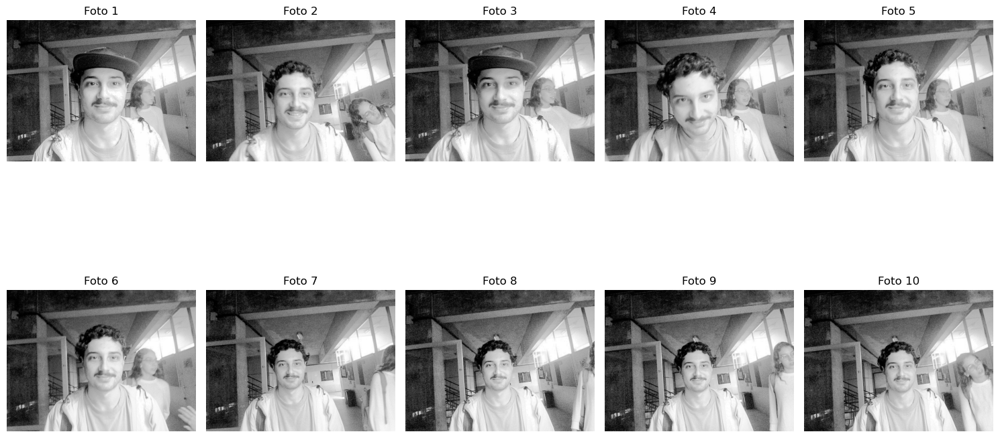

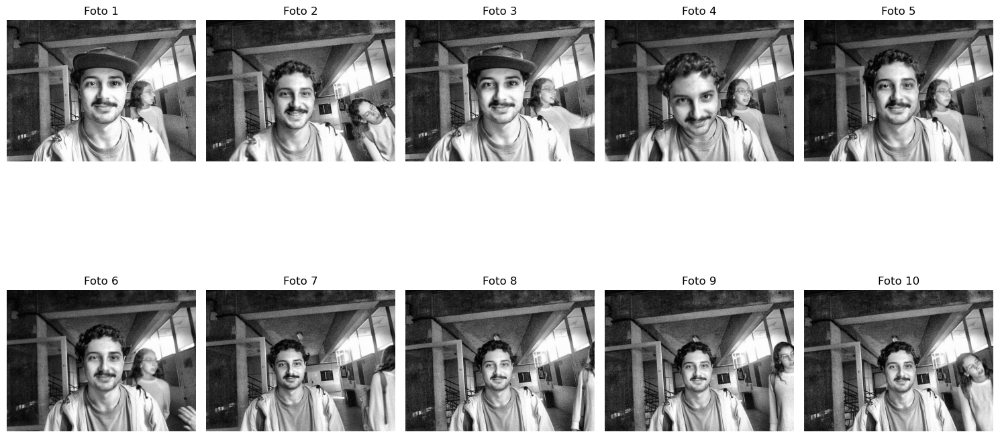

In [30]:
plotar_fotos("correcao_gamma")
plotar_fotos("equalizacao_histograma")
plotar_fotos("equalizacao_histograma_localizada")

Parece que equalização de histograma global fornece menor qualidade da imagem da face que a equalização localizada (clahe). Vou testar juntar a equalização localizada com a correção gamma

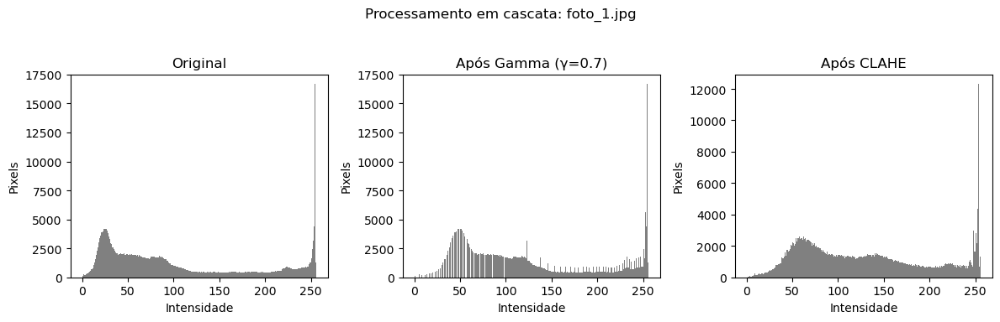

foto_1.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_1.jpg


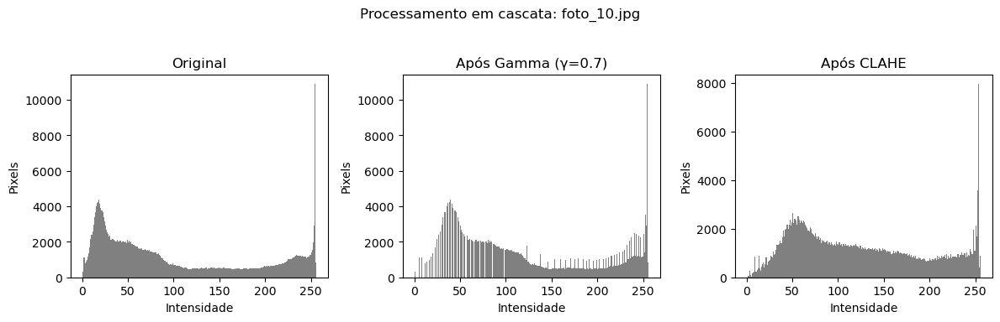

foto_10.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_10.jpg


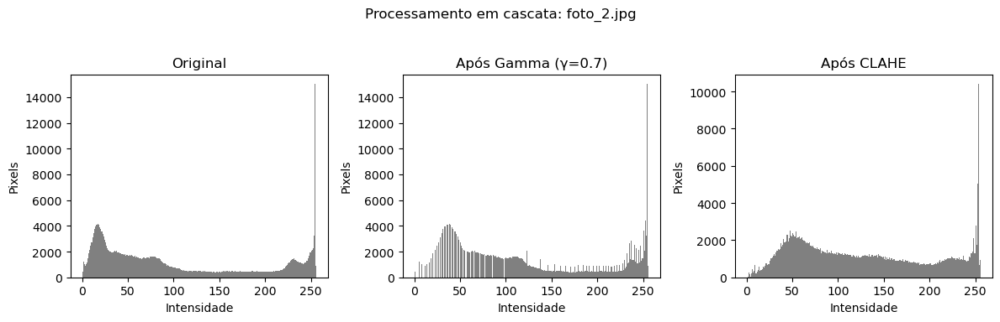

foto_2.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_2.jpg


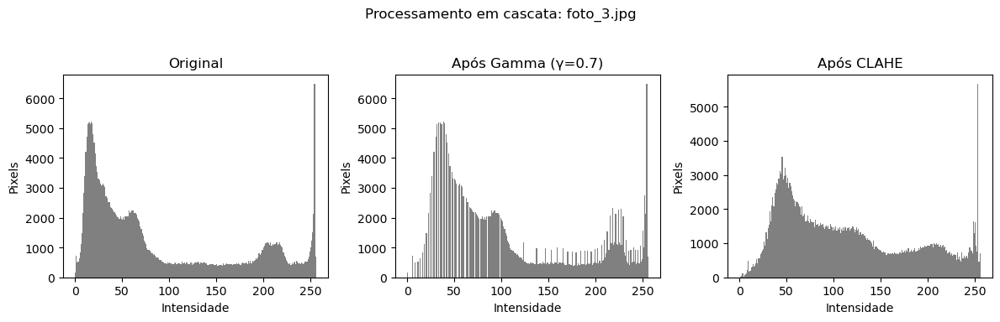

foto_3.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_3.jpg


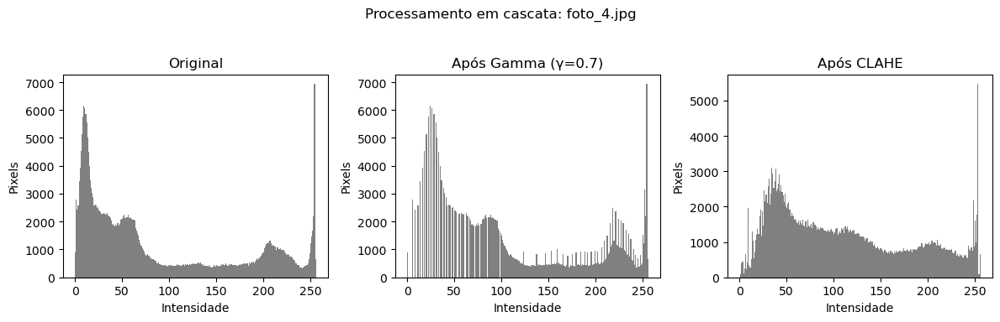

foto_4.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_4.jpg


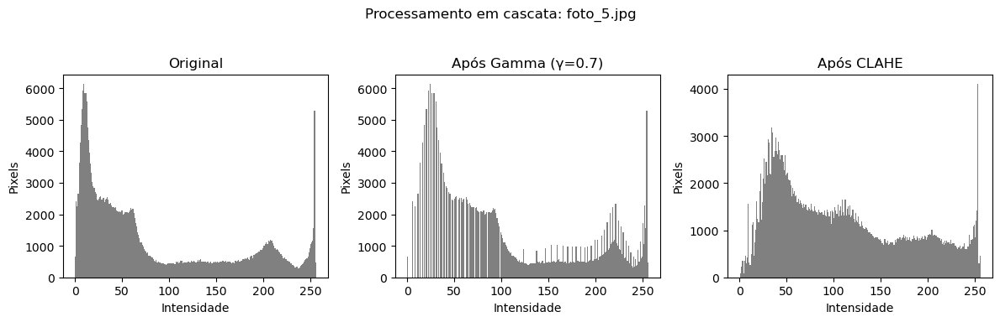

foto_5.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_5.jpg


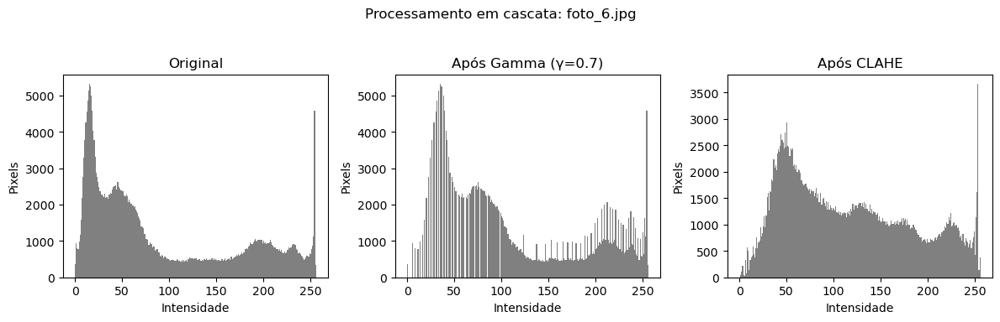

foto_6.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_6.jpg


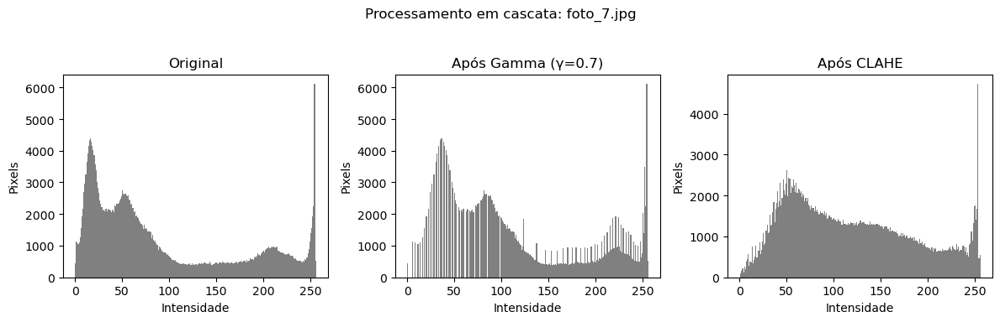

foto_7.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_7.jpg


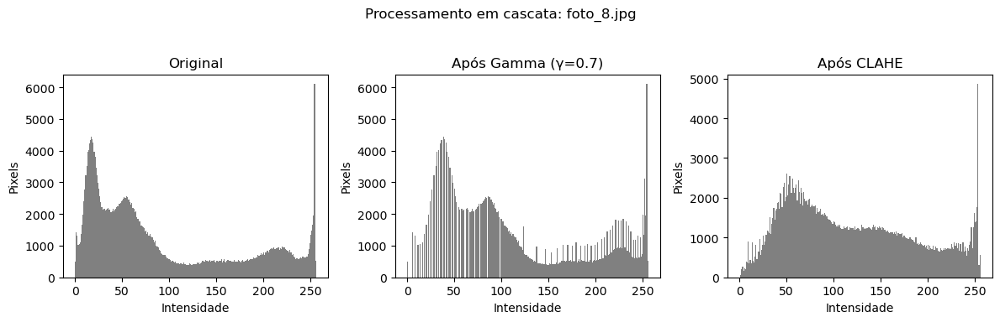

foto_8.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_8.jpg


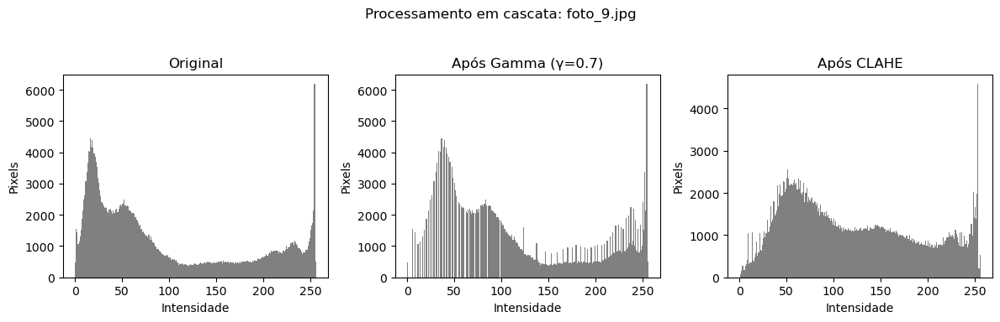

foto_9.jpg processada com gamma+CLAHE e salva em teste_cinza_gamma_clahe\foto_9.jpg


In [31]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'teste_cinza_gamma_clahe'

os.makedirs(pasta_saida, exist_ok=True)

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue

        media = np.mean(img)
        gamma = definir_gamma(media)
        img_gamma = gamma_correction(img, gamma)
        img_final = clahe.apply(img_gamma)

        # Plotar histogramas
        plt.figure(figsize=(12, 4))

        plt.subplot(1, 3, 1)
        plt.title('Original')
        plt.hist(img.ravel(), bins=256, range=[0, 256], color='gray')
        plt.xlabel('Intensidade'); plt.ylabel('Pixels')

        plt.subplot(1, 3, 2)
        plt.title(f'Após Gamma (γ={gamma})')
        plt.hist(img_gamma.ravel(), bins=256, range=[0, 256], color='gray')
        plt.xlabel('Intensidade'); plt.ylabel('Pixels')

        plt.subplot(1, 3, 3)
        plt.title('Após CLAHE')
        plt.hist(img_final.ravel(), bins=256, range=[0, 256], color='gray')
        plt.xlabel('Intensidade'); plt.ylabel('Pixels')

        plt.suptitle(f"Processamento em cascata: {arquivo}")
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_final)
        print(f"{arquivo} processada com gamma+CLAHE e salva em {caminho_saida}")

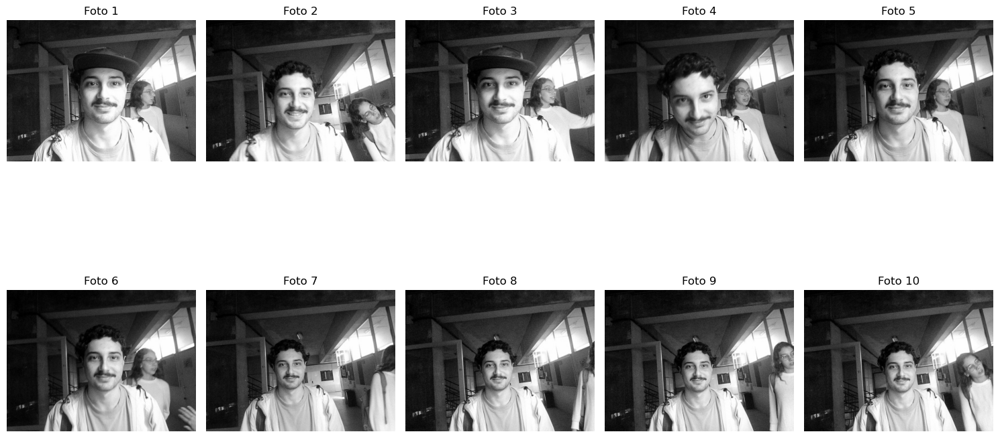

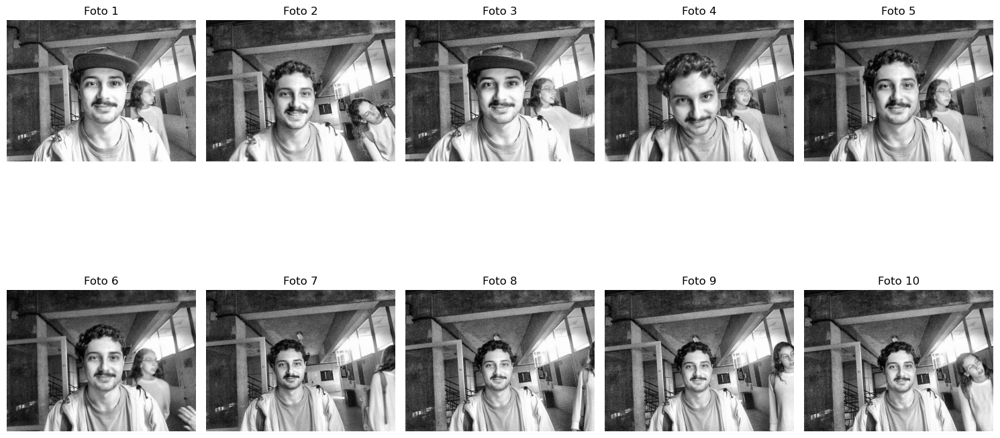

In [32]:
plotar_fotos("teste_cinza")
plotar_fotos("teste_cinza_gamma_clahe")

Me pareceu que as fotos ficaram mais ruidosas

Utilizando técnica no domínio da frequência: Filtragem homomórfica

In [33]:
def homomorphic_filter_adaptativo(img, c=1.0, d0=30):
    # Pré-processamento
    img_float = img.astype(np.float32) / 255.0
    img_log = np.log1p(img_float)

    # Adaptação de gamma
    media = np.mean(img)
    media_norm = media / 255.0
    gammaL = 0.5 + 0.3 * media_norm
    gammaH = 1.5 + 1.0 * (1 - media_norm)

    rows, cols = img.shape
    M, N = 2*rows, 2*cols

    img_fft = np.fft.fft2(img_log, s=(M, N))
    img_fft_shift = np.fft.fftshift(img_fft)

    # Filtro passa-alta gaussiano
    y, x = np.ogrid[:M, :N]
    center_y, center_x = M//2, N//2
    distance = ((y - center_y)**2 + (x - center_x)**2)
    H = (gammaH - gammaL) * (1 - np.exp(-c * distance / (d0**2))) + gammaL

    # Aplicação do filtro
    filtered_fft = H * img_fft_shift
    img_ifft = np.fft.ifftshift(filtered_fft)
    img_out = np.fft.ifft2(img_ifft)
    img_out = np.real(img_out[:rows, :cols])  # remover padding

    # Pós-processamento
    img_exp = np.expm1(img_out)
    img_exp = np.clip(img_exp, 0, None)
    img_norm = cv2.normalize(img_exp, None, 0, 255, cv2.NORM_MINMAX)
    return img_norm.astype(np.uint8)


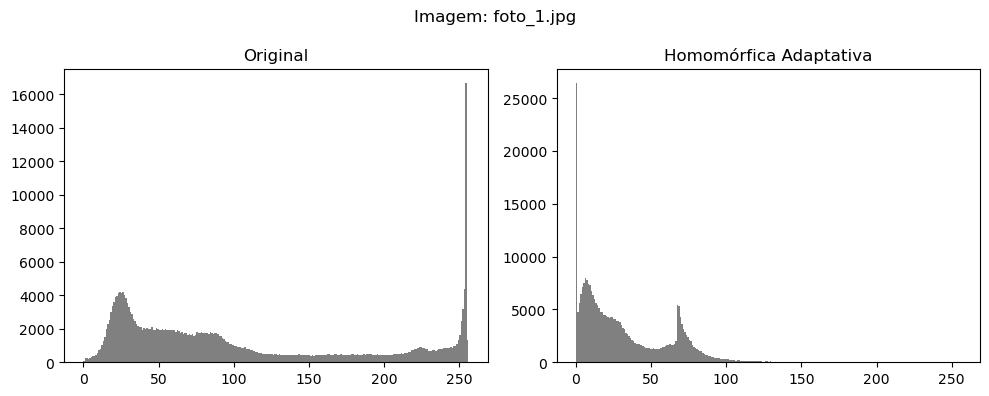

foto_1.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_1.jpg


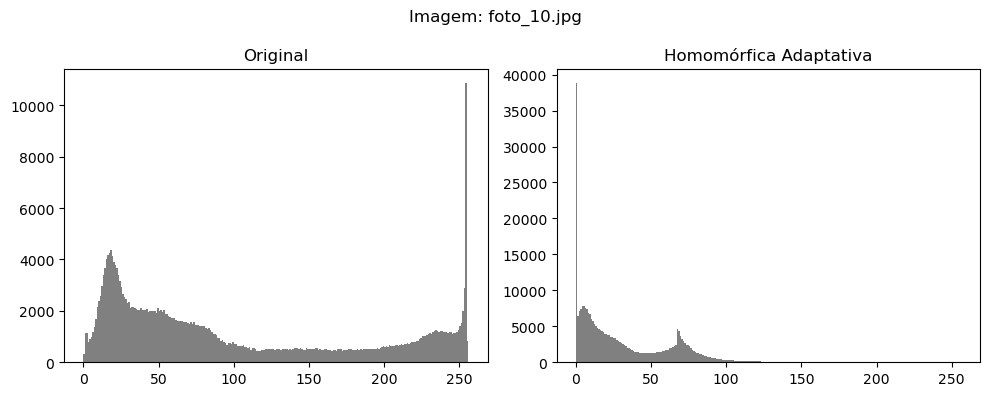

foto_10.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_10.jpg


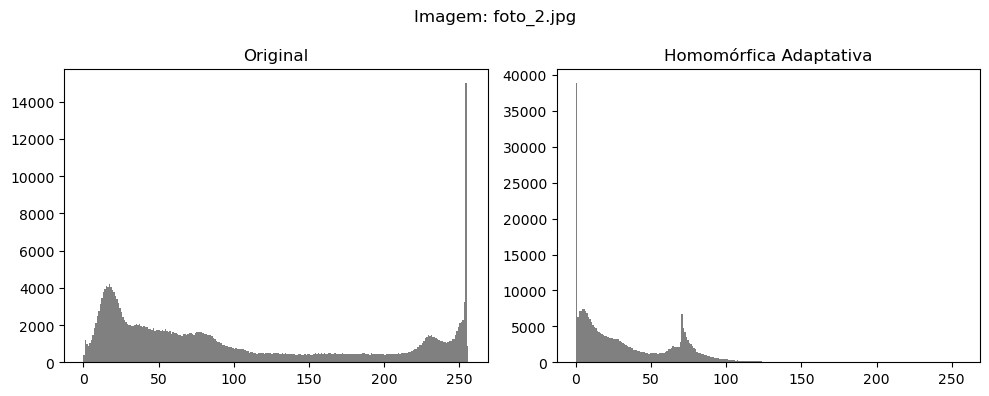

foto_2.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_2.jpg


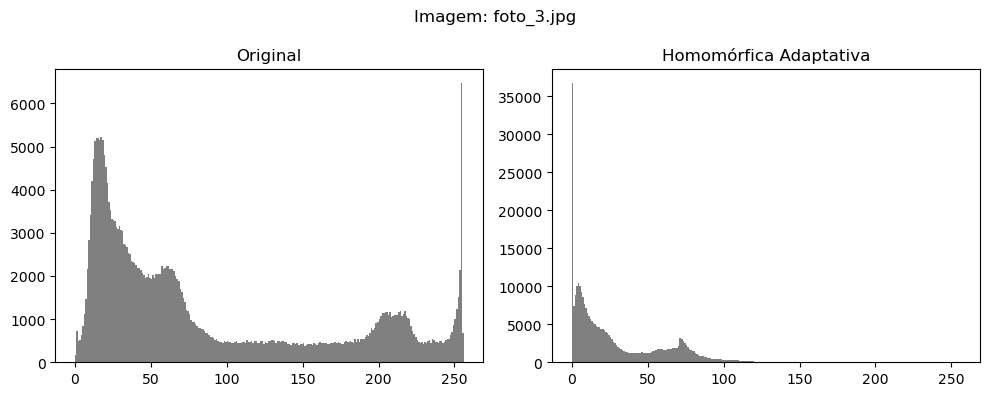

foto_3.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_3.jpg


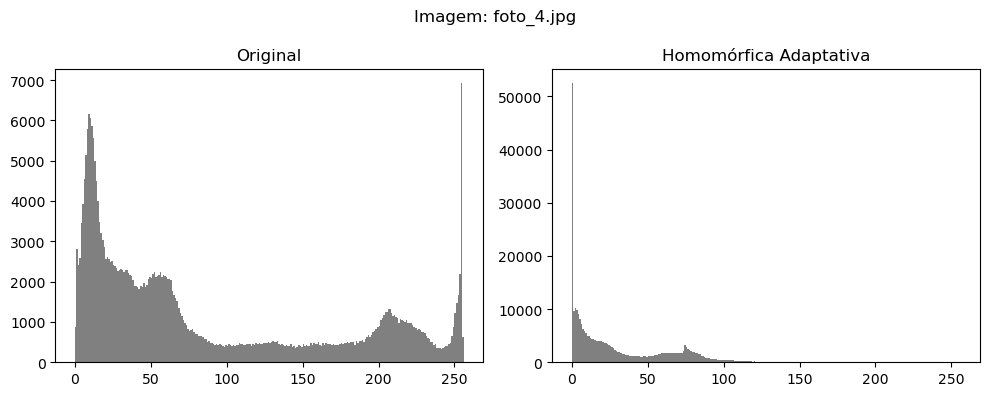

foto_4.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_4.jpg


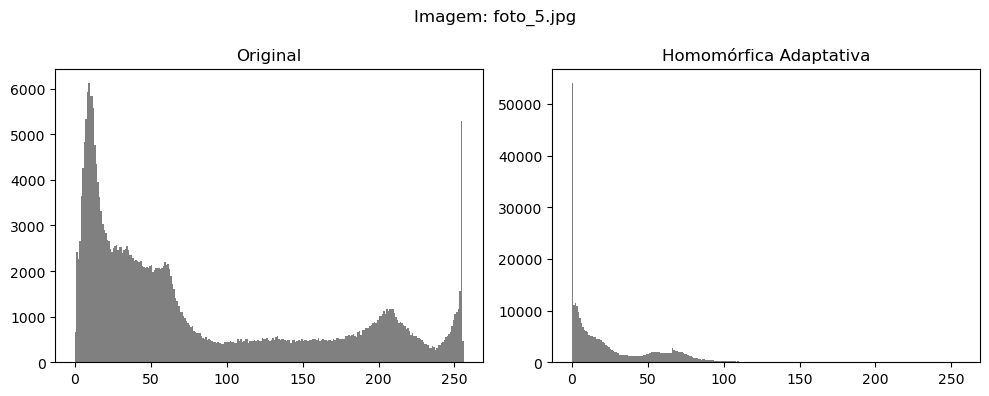

foto_5.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_5.jpg


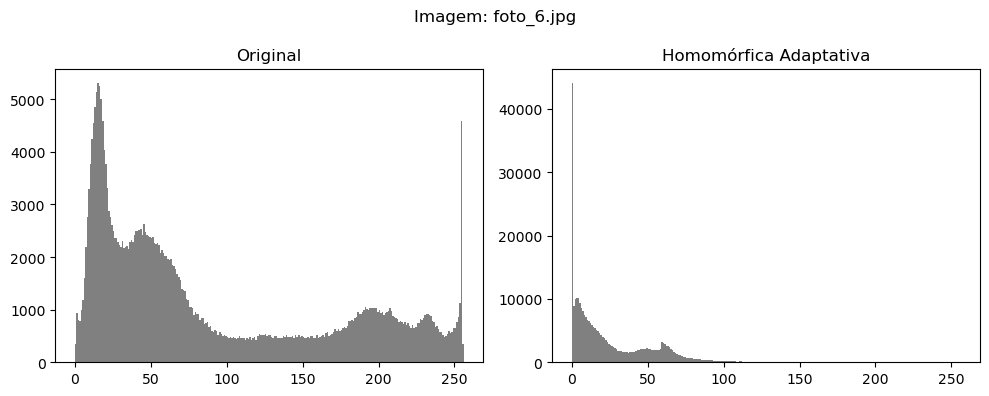

foto_6.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_6.jpg


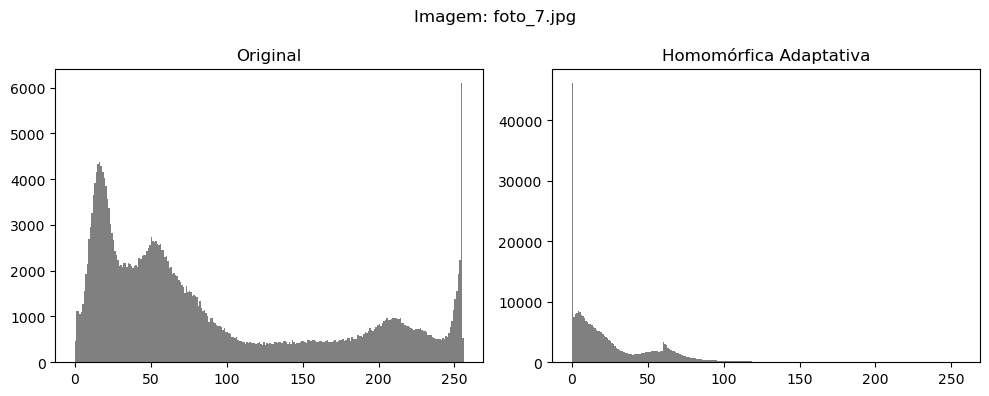

foto_7.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_7.jpg


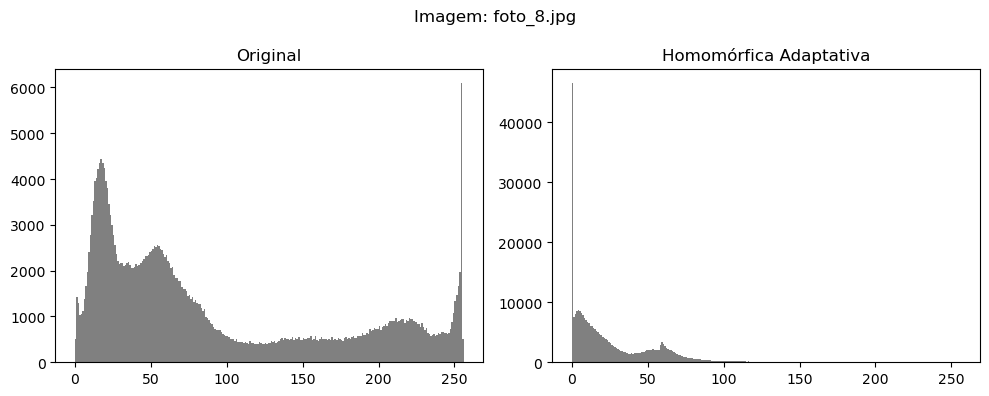

foto_8.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_8.jpg


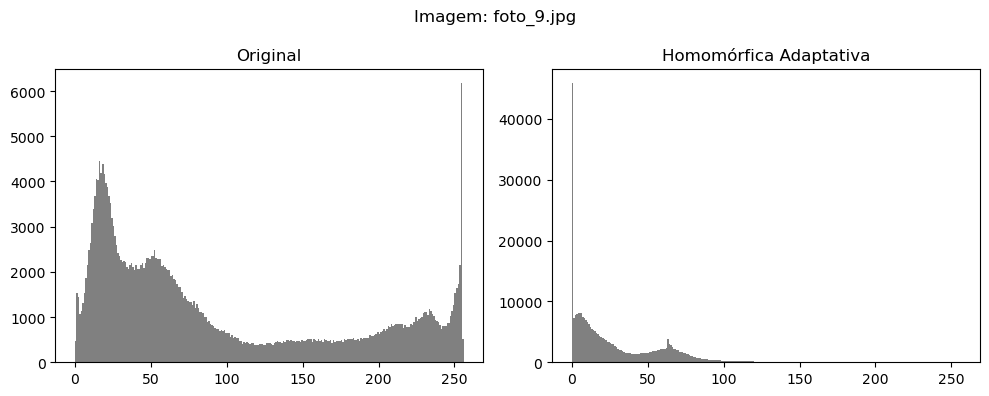

foto_9.jpg filtrada com homomórfica adaptativa e salva em teste_cinza_homomorfica\foto_9.jpg


In [34]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'teste_cinza_homomorfica'
os.makedirs(pasta_saida, exist_ok=True)

# Loop nas imagens
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue

        img_filtrada = homomorphic_filter_adaptativo(img)

        # Mostrar histograma antes/depois
        plt.figure(figsize=(10, 4))
        plt.subplot(1, 2, 1)
        plt.title('Original')
        plt.hist(img.ravel(), bins=256, range=[0, 256], color='gray')
        plt.subplot(1, 2, 2)
        plt.title('Homomórfica Adaptativa')
        plt.hist(img_filtrada.ravel(), bins=256, range=[0, 256], color='gray')
        plt.suptitle(f'Imagem: {arquivo}')
        plt.tight_layout()
        plt.show()

        # Salvar imagem processada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_filtrada)
        print(f"{arquivo} filtrada com homomórfica adaptativa e salva em {caminho_saida}")

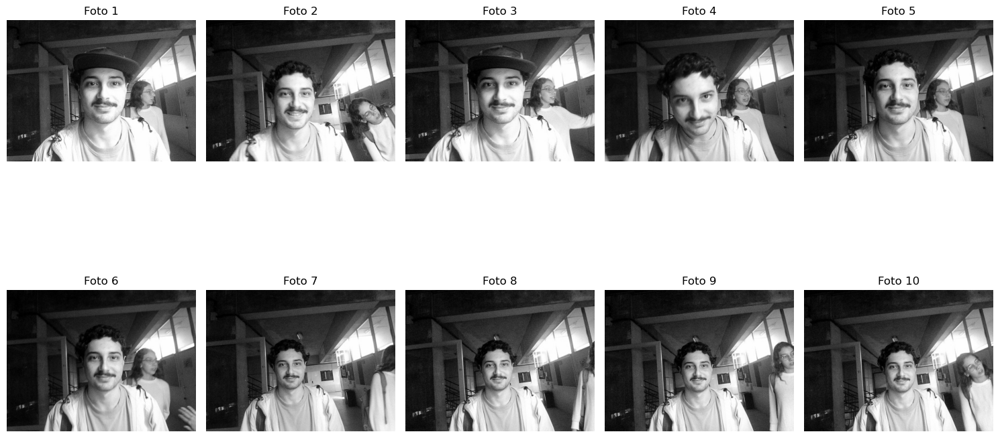

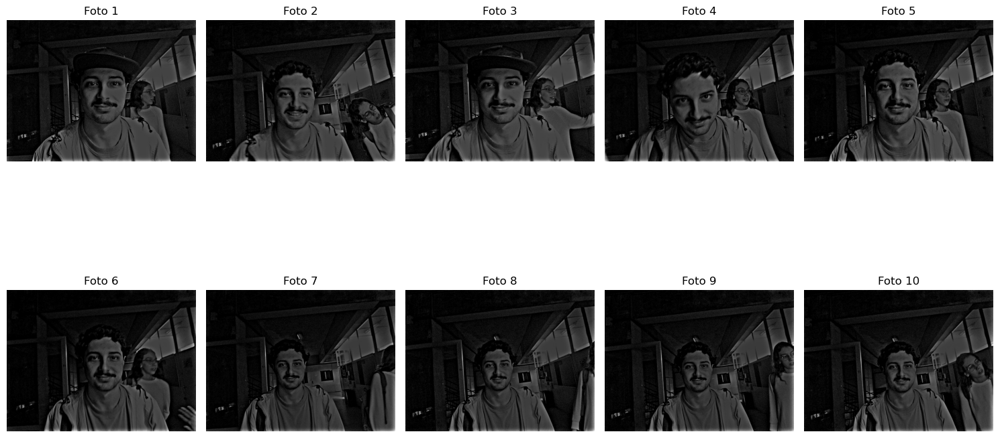

In [35]:
plotar_fotos("teste_cinza")
plotar_fotos("teste_cinza_homomorfica")

### Etapa de filtragem de ruídos

Filtro de média móvel (avearaging) - domínio das amostras

In [42]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'teste_media_movel'
os.makedirs(pasta_saida, exist_ok=True)

# Loop nas imagens
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        kernel_size = 5  # ou 3, 7, etc.
        img_filtrada = cv2.blur(img, (kernel_size, kernel_size))

        # Salvar imagem processada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_filtrada)
        print(f"{arquivo} filtrada com média móvel e salva em {caminho_saida}")

foto_1.jpg filtrada com média móvel e salva em teste_media_movel\foto_1.jpg
foto_10.jpg filtrada com média móvel e salva em teste_media_movel\foto_10.jpg
foto_2.jpg filtrada com média móvel e salva em teste_media_movel\foto_2.jpg
foto_3.jpg filtrada com média móvel e salva em teste_media_movel\foto_3.jpg
foto_4.jpg filtrada com média móvel e salva em teste_media_movel\foto_4.jpg
foto_5.jpg filtrada com média móvel e salva em teste_media_movel\foto_5.jpg
foto_6.jpg filtrada com média móvel e salva em teste_media_movel\foto_6.jpg
foto_7.jpg filtrada com média móvel e salva em teste_media_movel\foto_7.jpg
foto_8.jpg filtrada com média móvel e salva em teste_media_movel\foto_8.jpg
foto_9.jpg filtrada com média móvel e salva em teste_media_movel\foto_9.jpg


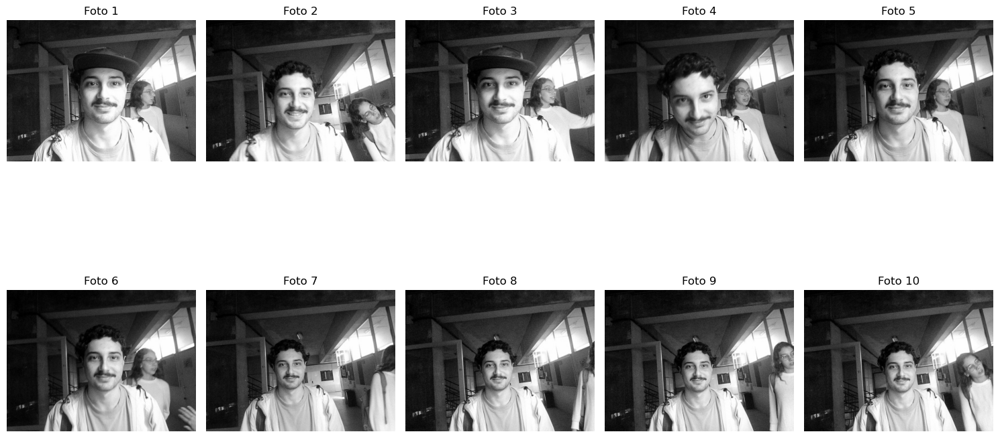

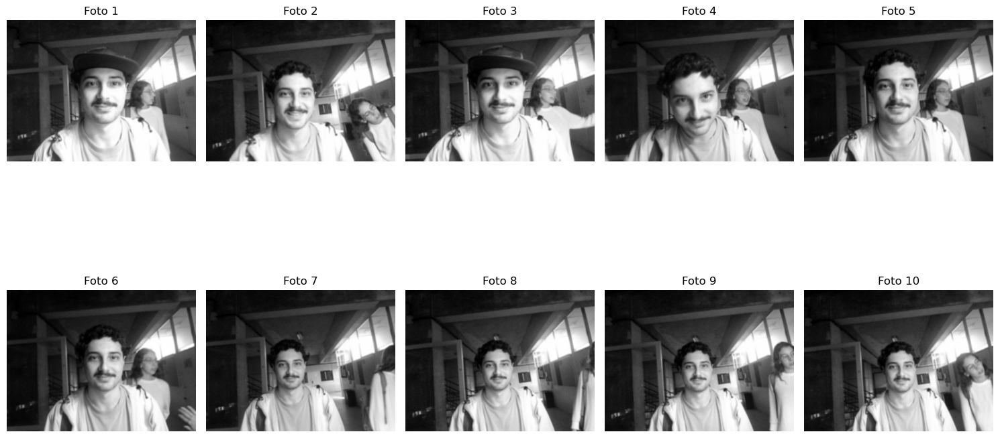

In [43]:
plotar_fotos("teste_cinza")
plotar_fotos("teste_media_movel")

Ficou pior. Vou testar com kernel mais baixo

In [44]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'teste_media_movel'
os.makedirs(pasta_saida, exist_ok=True)

# Loop nas imagens
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        kernel_size = 3
        img_filtrada = cv2.blur(img, (kernel_size, kernel_size))

        # Salvar imagem processada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_filtrada)
        print(f"{arquivo} filtrada com média móvel e salva em {caminho_saida}")

foto_1.jpg filtrada com média móvel e salva em teste_media_movel\foto_1.jpg
foto_10.jpg filtrada com média móvel e salva em teste_media_movel\foto_10.jpg
foto_2.jpg filtrada com média móvel e salva em teste_media_movel\foto_2.jpg
foto_3.jpg filtrada com média móvel e salva em teste_media_movel\foto_3.jpg
foto_4.jpg filtrada com média móvel e salva em teste_media_movel\foto_4.jpg
foto_5.jpg filtrada com média móvel e salva em teste_media_movel\foto_5.jpg
foto_6.jpg filtrada com média móvel e salva em teste_media_movel\foto_6.jpg
foto_7.jpg filtrada com média móvel e salva em teste_media_movel\foto_7.jpg
foto_8.jpg filtrada com média móvel e salva em teste_media_movel\foto_8.jpg
foto_9.jpg filtrada com média móvel e salva em teste_media_movel\foto_9.jpg


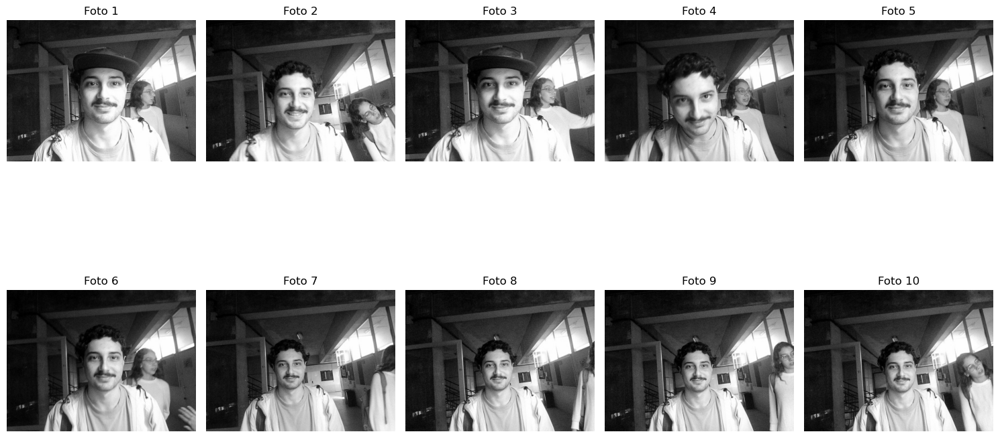

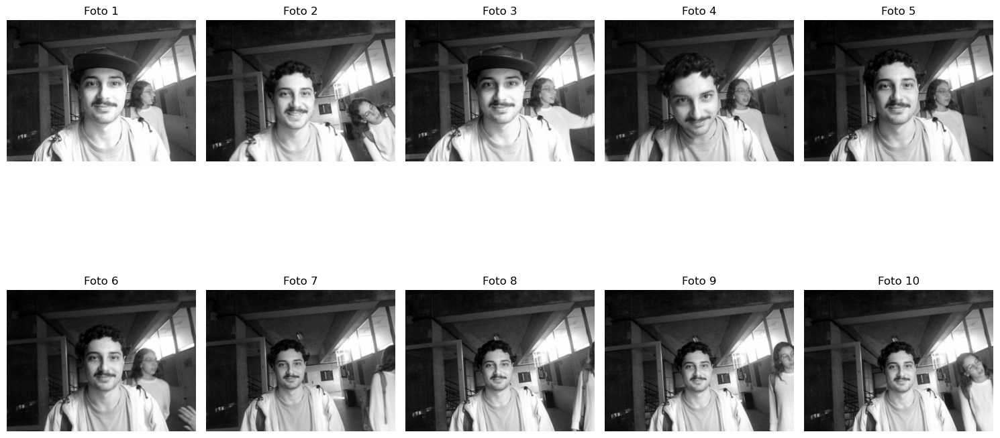

In [45]:
plotar_fotos("teste_cinza")
plotar_fotos("teste_media_movel")

In [46]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'teste_media_movel'
os.makedirs(pasta_saida, exist_ok=True)

# Loop nas imagens
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        kernel_size = 2
        img_filtrada = cv2.blur(img, (kernel_size, kernel_size))

        # Salvar imagem processada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_filtrada)
        print(f"{arquivo} filtrada com média móvel e salva em {caminho_saida}")

foto_1.jpg filtrada com média móvel e salva em teste_media_movel\foto_1.jpg
foto_10.jpg filtrada com média móvel e salva em teste_media_movel\foto_10.jpg
foto_2.jpg filtrada com média móvel e salva em teste_media_movel\foto_2.jpg
foto_3.jpg filtrada com média móvel e salva em teste_media_movel\foto_3.jpg
foto_4.jpg filtrada com média móvel e salva em teste_media_movel\foto_4.jpg
foto_5.jpg filtrada com média móvel e salva em teste_media_movel\foto_5.jpg
foto_6.jpg filtrada com média móvel e salva em teste_media_movel\foto_6.jpg
foto_7.jpg filtrada com média móvel e salva em teste_media_movel\foto_7.jpg
foto_8.jpg filtrada com média móvel e salva em teste_media_movel\foto_8.jpg
foto_9.jpg filtrada com média móvel e salva em teste_media_movel\foto_9.jpg


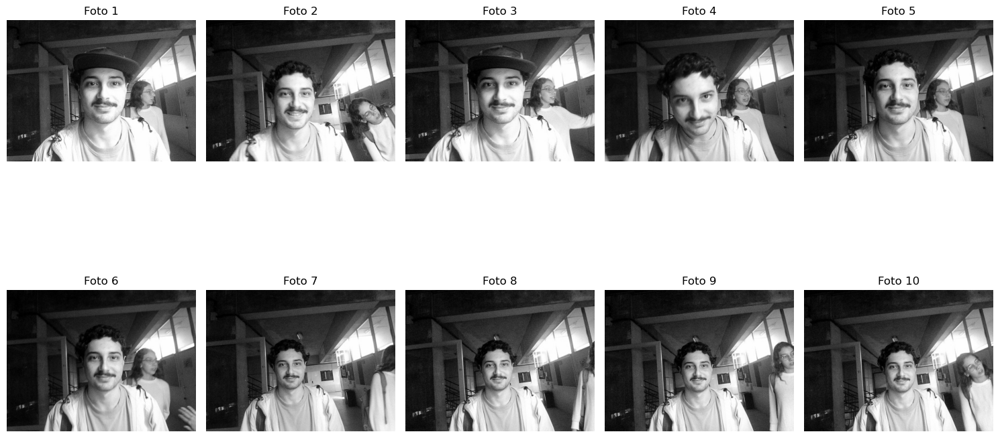

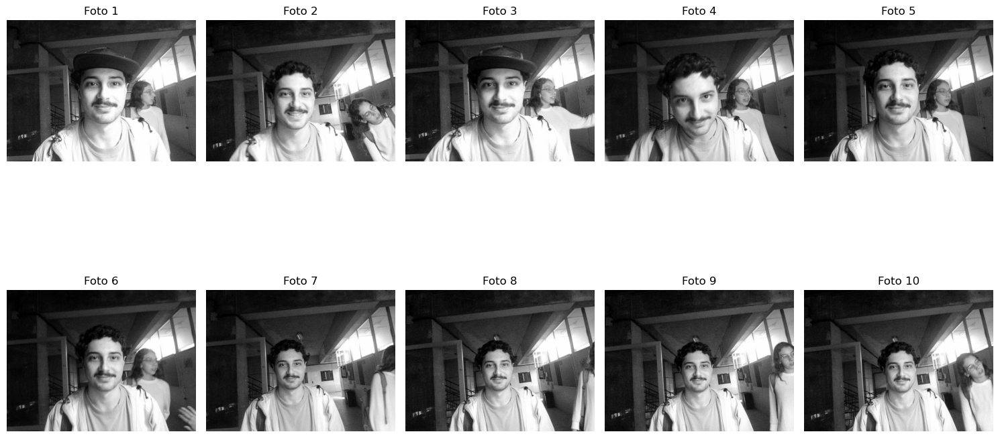

In [47]:
plotar_fotos("teste_cinza")
plotar_fotos("teste_media_movel")

Filtro de mediana - domínio das amostras

In [66]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'teste_mediana'
os.makedirs(pasta_saida, exist_ok=True)

# Loop nas imagens
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        kernel_size = 3
        img_filtrada = cv2.medianBlur(img, kernel_size)

        # Salvar imagem processada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_filtrada)
        print(f"{arquivo} filtrada com média móvel e salva em {caminho_saida}")

foto_1.jpg filtrada com média móvel e salva em teste_mediana\foto_1.jpg
foto_10.jpg filtrada com média móvel e salva em teste_mediana\foto_10.jpg
foto_2.jpg filtrada com média móvel e salva em teste_mediana\foto_2.jpg
foto_3.jpg filtrada com média móvel e salva em teste_mediana\foto_3.jpg
foto_4.jpg filtrada com média móvel e salva em teste_mediana\foto_4.jpg
foto_5.jpg filtrada com média móvel e salva em teste_mediana\foto_5.jpg
foto_6.jpg filtrada com média móvel e salva em teste_mediana\foto_6.jpg
foto_7.jpg filtrada com média móvel e salva em teste_mediana\foto_7.jpg
foto_8.jpg filtrada com média móvel e salva em teste_mediana\foto_8.jpg
foto_9.jpg filtrada com média móvel e salva em teste_mediana\foto_9.jpg


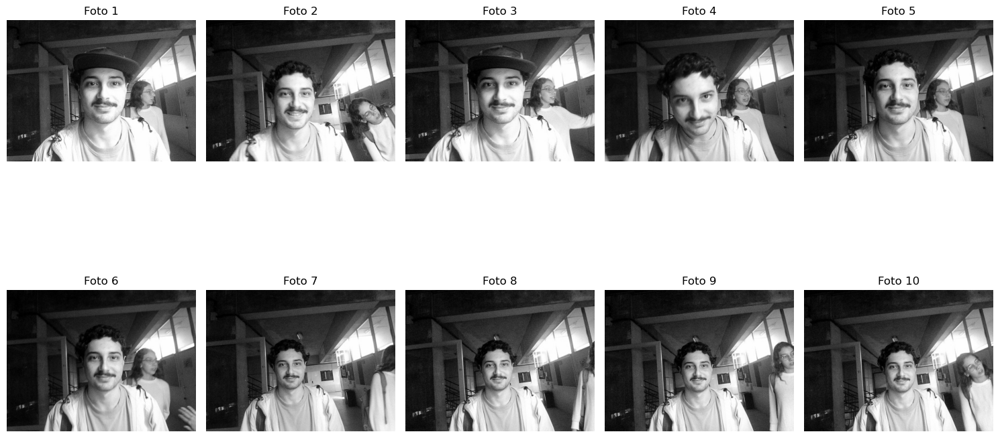

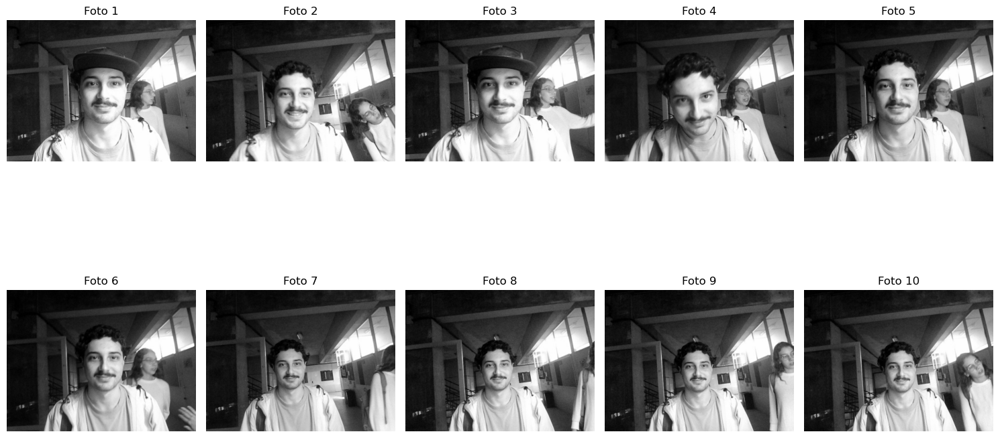

In [67]:
plotar_fotos("teste_cinza")
plotar_fotos("teste_mediana")

Aumentando o kernel

In [73]:
pasta_entrada = 'equalizacao_histograma_localizada'
pasta_saida = 'teste_mediana'
os.makedirs(pasta_saida, exist_ok=True)

# Loop nas imagens
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        kernel_size = 5
        img_filtrada = cv2.medianBlur(img, kernel_size)

        # Salvar imagem processada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_filtrada)
        print(f"{arquivo} filtrada com média móvel e salva em {caminho_saida}")

foto_1.jpg filtrada com média móvel e salva em teste_mediana\foto_1.jpg
foto_10.jpg filtrada com média móvel e salva em teste_mediana\foto_10.jpg
foto_2.jpg filtrada com média móvel e salva em teste_mediana\foto_2.jpg
foto_3.jpg filtrada com média móvel e salva em teste_mediana\foto_3.jpg
foto_4.jpg filtrada com média móvel e salva em teste_mediana\foto_4.jpg
foto_5.jpg filtrada com média móvel e salva em teste_mediana\foto_5.jpg
foto_6.jpg filtrada com média móvel e salva em teste_mediana\foto_6.jpg
foto_7.jpg filtrada com média móvel e salva em teste_mediana\foto_7.jpg
foto_8.jpg filtrada com média móvel e salva em teste_mediana\foto_8.jpg
foto_9.jpg filtrada com média móvel e salva em teste_mediana\foto_9.jpg


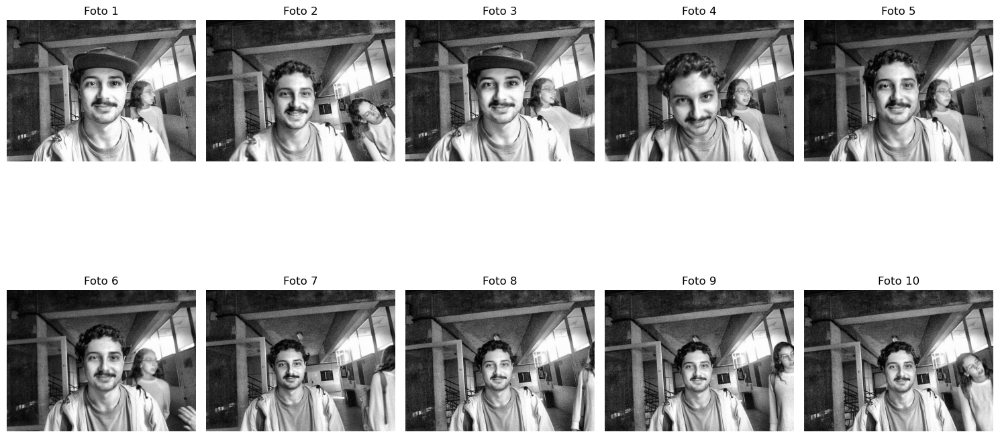

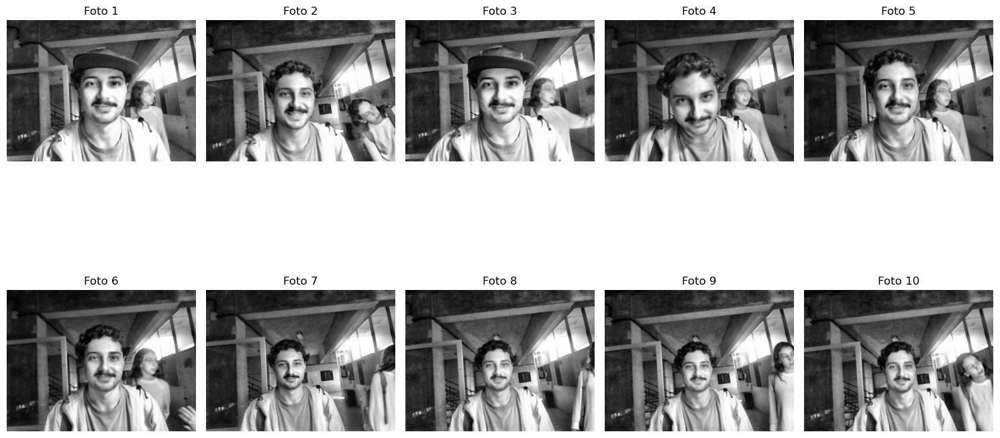

In [75]:
plotar_fotos("equalizacao_histograma_localizada")
plotar_fotos("teste_mediana")

O filtro mediana a princípio não melhora muito a imagem

Filtro passa baixas - domínio da frequência

In [56]:
def low_pass_filter(imagem, raio=30):
    # 1. Converter para float e aplicar DFT
    img_float = np.float32(imagem)
    dft = cv2.dft(img_float, flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)

    # 2. Criar máscara passa-baixa
    linhas, colunas = imagem.shape
    cx, cy = colunas // 2, linhas // 2
    mask = np.zeros((linhas, colunas, 2), np.uint8)
    cv2.circle(mask, (cx, cy), raio, (1, 1), -1)

    # 3. Aplicar máscara no domínio da frequência
    dft_shift_filtrado = dft_shift * mask

    # 4. Transformada inversa para voltar ao domínio espacial
    dft_ishift = np.fft.ifftshift(dft_shift_filtrado)
    img_back = cv2.idft(dft_ishift)
    img_back = cv2.magnitude(img_back[:, :, 0], img_back[:, :, 1])

    # 5. Calcular espectros para visualização
    espectro_original = np.log(1 + cv2.magnitude(dft_shift[:, :, 0], dft_shift[:, :, 1]))
    espectro_filtrado = np.log(1 + cv2.magnitude(dft_shift_filtrado[:, :, 0], dft_shift_filtrado[:, :, 1]))
    mask_vis = mask[:, :, 0] * 255  # Para exibir a máscara como imagem
    img_back = cv2.normalize(img_back, None, 0, 255, cv2.NORM_MINMAX)
    img_back = np.uint8(img_back)
    # 6. Mostrar tudo
    plt.figure(figsize=(6, 4))

    plt.subplot(2, 2, 1)
    plt.title("Imagem original")
    plt.imshow(imagem, cmap='gray')
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.title("Espectro original (log)")
    plt.imshow(espectro_original, cmap='gray')
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.title(f"Máscara (passa-baixa, raio={raio})")
    plt.imshow(mask_vis, cmap='gray')
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.title("Espectro filtrado (log)")
    plt.imshow(espectro_filtrado, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return img_back


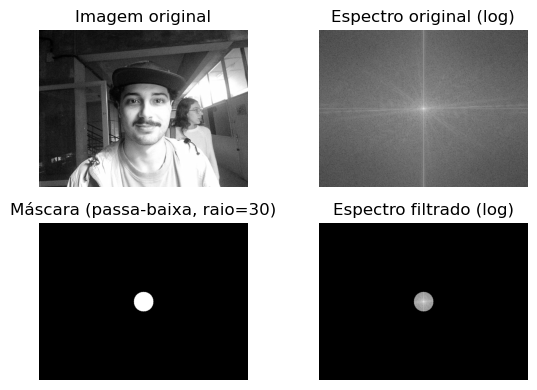

foto_1.jpg filtrada com lpf e salva em teste_lpf\foto_1.jpg


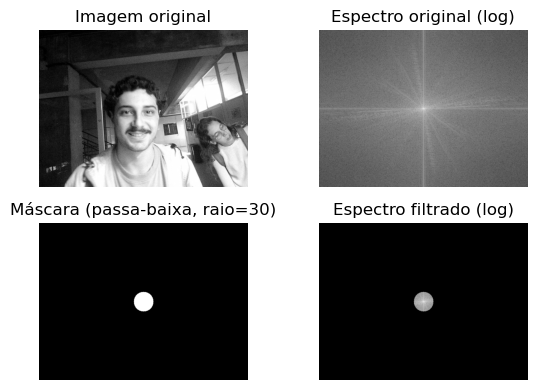

foto_10.jpg filtrada com lpf e salva em teste_lpf\foto_10.jpg


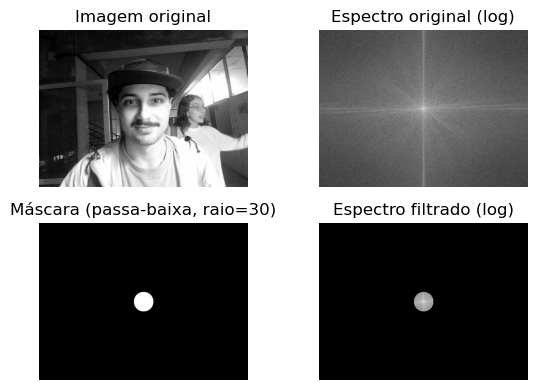

foto_2.jpg filtrada com lpf e salva em teste_lpf\foto_2.jpg


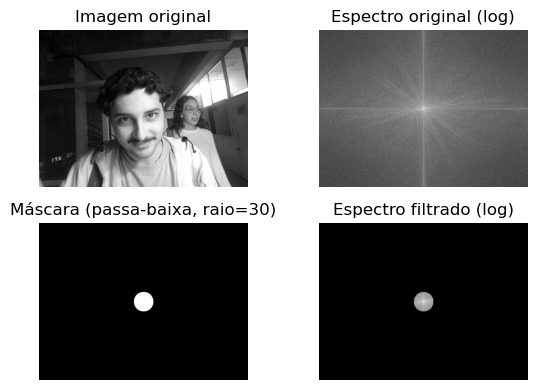

foto_3.jpg filtrada com lpf e salva em teste_lpf\foto_3.jpg


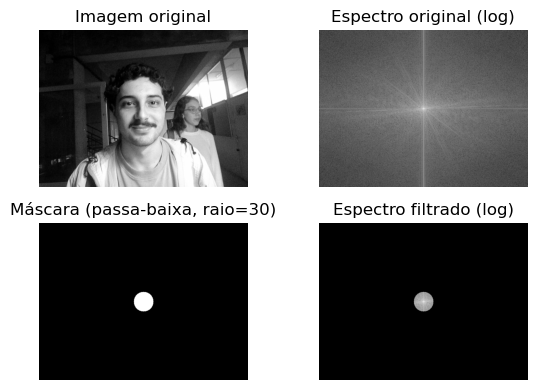

foto_4.jpg filtrada com lpf e salva em teste_lpf\foto_4.jpg


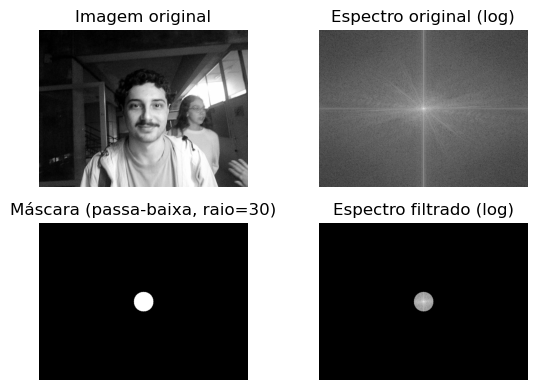

foto_5.jpg filtrada com lpf e salva em teste_lpf\foto_5.jpg


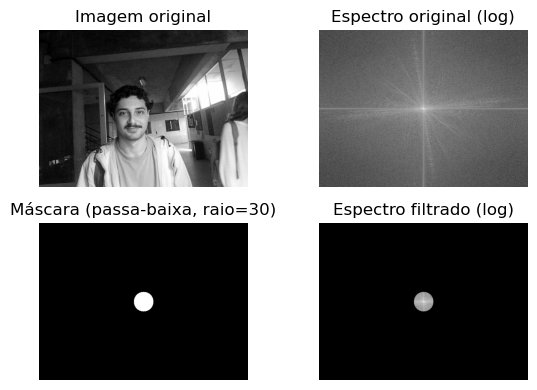

foto_6.jpg filtrada com lpf e salva em teste_lpf\foto_6.jpg


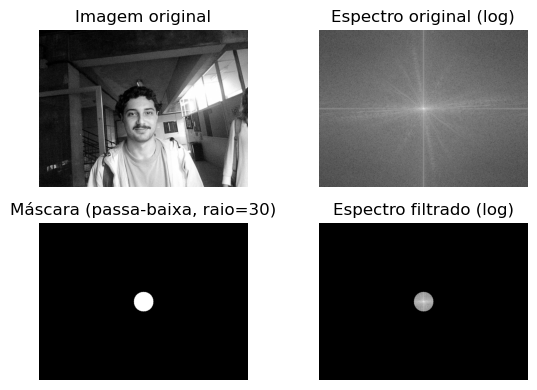

foto_7.jpg filtrada com lpf e salva em teste_lpf\foto_7.jpg


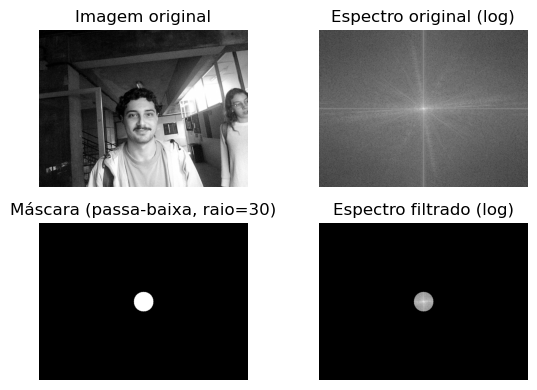

foto_8.jpg filtrada com lpf e salva em teste_lpf\foto_8.jpg


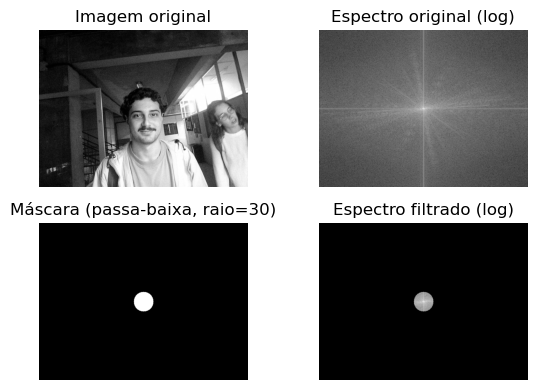

foto_9.jpg filtrada com lpf e salva em teste_lpf\foto_9.jpg


In [57]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'teste_lpf'
os.makedirs(pasta_saida, exist_ok=True)

# Loop nas imagens
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        raio = 30
        img_filtrada = low_pass_filter(img, raio=raio)

        # Salvar imagem processada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_filtrada)
        print(f"{arquivo} filtrada com lpf e salva em {caminho_saida}")

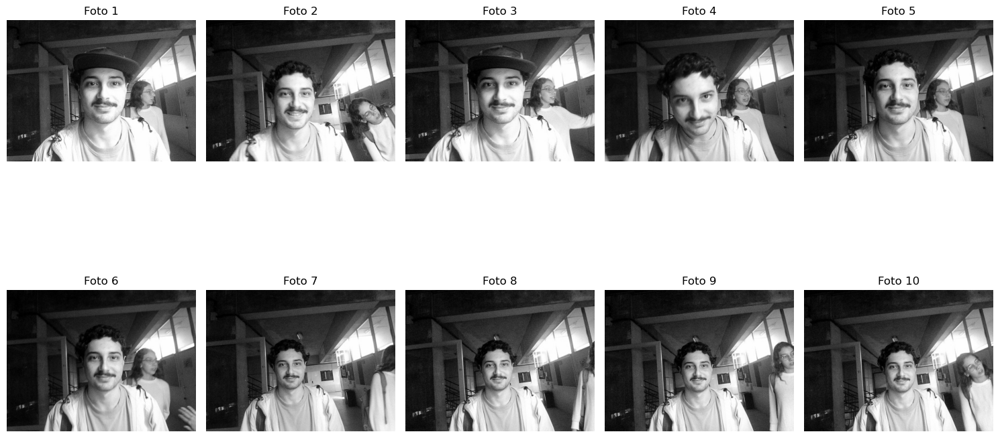

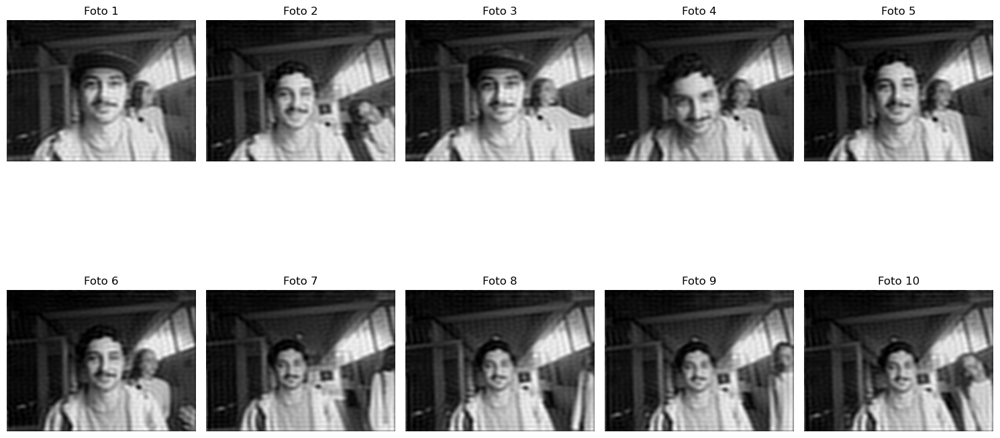

In [58]:
plotar_fotos("teste_cinza")
plotar_fotos("teste_lpf")

Raio muito pequeno

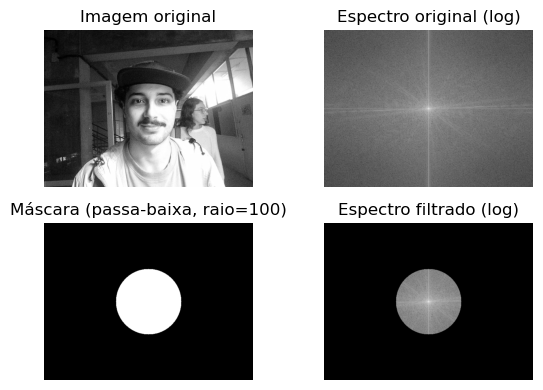

foto_1.jpg filtrada com lpf e salva em teste_lpf\foto_1.jpg


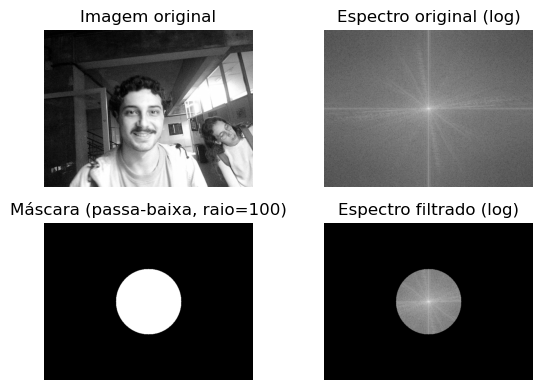

foto_10.jpg filtrada com lpf e salva em teste_lpf\foto_10.jpg


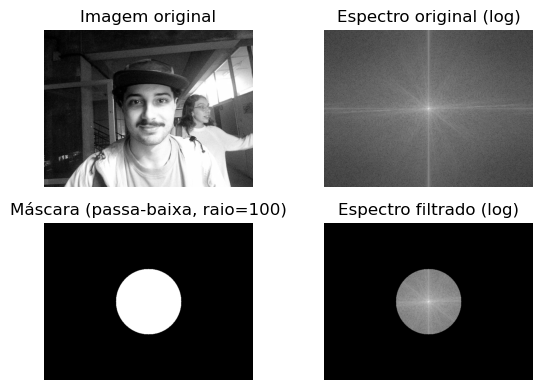

foto_2.jpg filtrada com lpf e salva em teste_lpf\foto_2.jpg


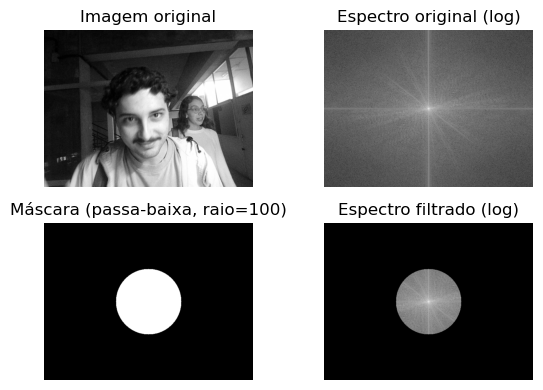

foto_3.jpg filtrada com lpf e salva em teste_lpf\foto_3.jpg


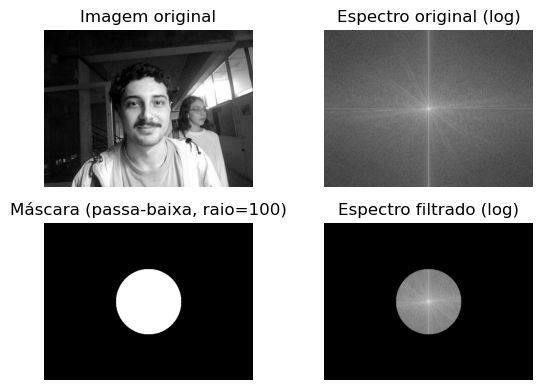

foto_4.jpg filtrada com lpf e salva em teste_lpf\foto_4.jpg


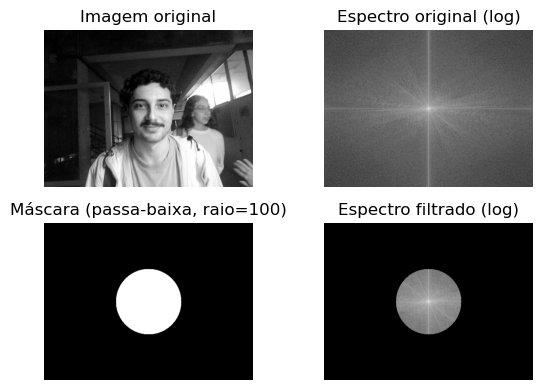

foto_5.jpg filtrada com lpf e salva em teste_lpf\foto_5.jpg


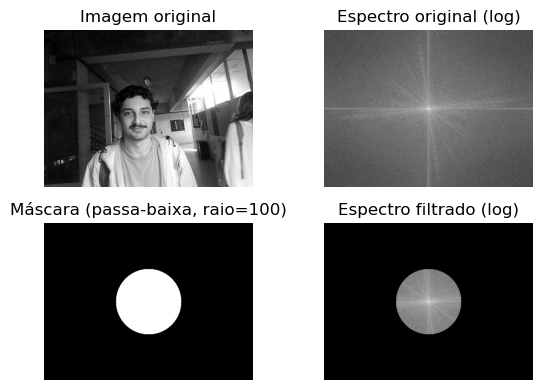

foto_6.jpg filtrada com lpf e salva em teste_lpf\foto_6.jpg


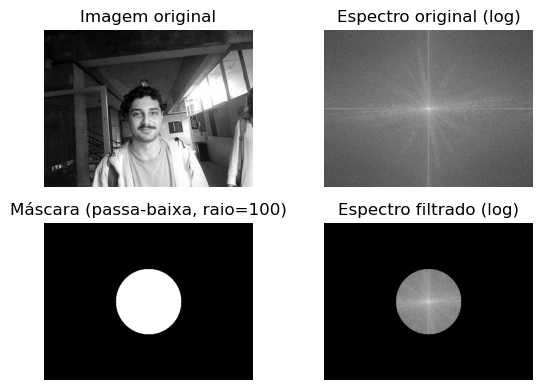

foto_7.jpg filtrada com lpf e salva em teste_lpf\foto_7.jpg


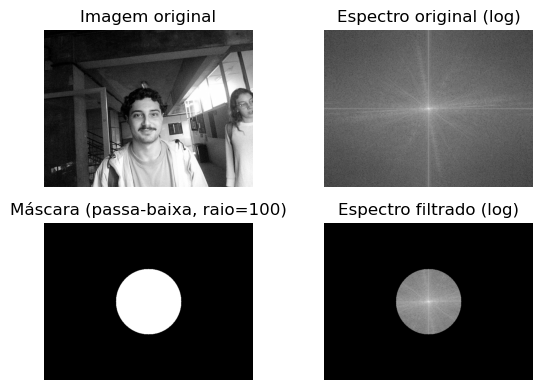

foto_8.jpg filtrada com lpf e salva em teste_lpf\foto_8.jpg


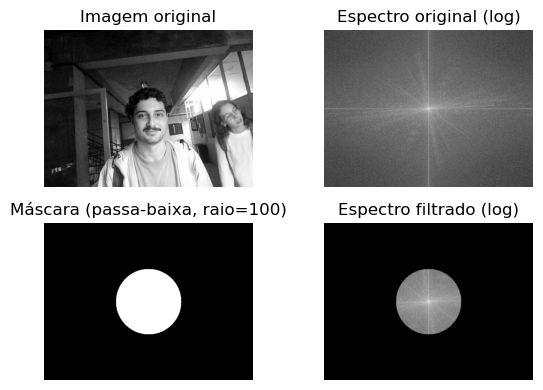

foto_9.jpg filtrada com lpf e salva em teste_lpf\foto_9.jpg


In [59]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'teste_lpf'
os.makedirs(pasta_saida, exist_ok=True)

# Loop nas imagens
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        raio = 100 #aumento do raio
        img_filtrada = low_pass_filter(img, raio=raio)

        # Salvar imagem processada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_filtrada)
        print(f"{arquivo} filtrada com lpf e salva em {caminho_saida}")

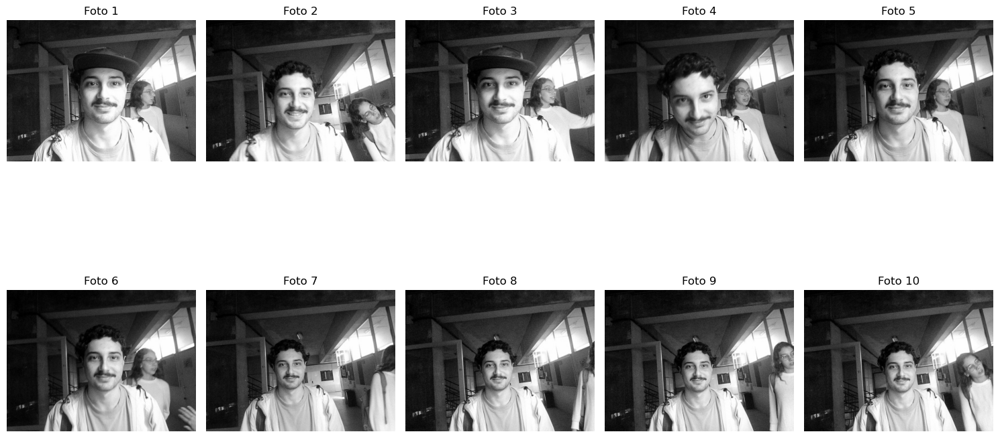

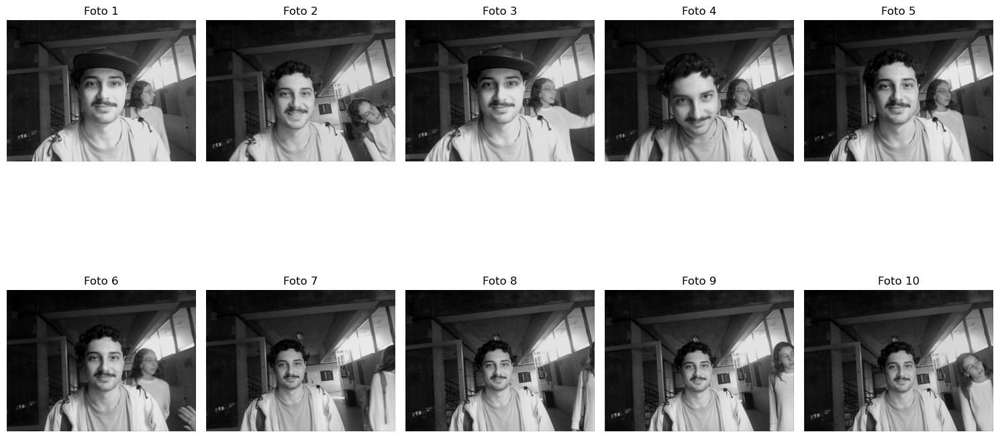

In [60]:
plotar_fotos("teste_cinza")
plotar_fotos("teste_lpf")

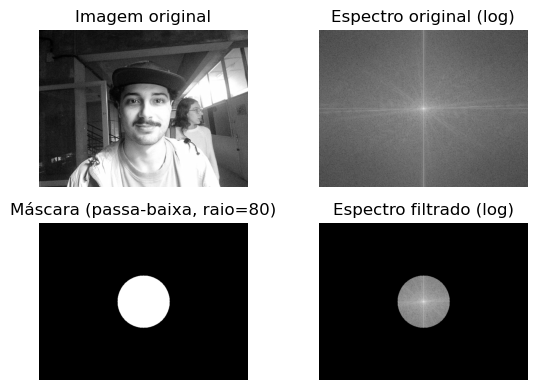

foto_1.jpg filtrada com lpf e salva em teste_lpf\foto_1.jpg


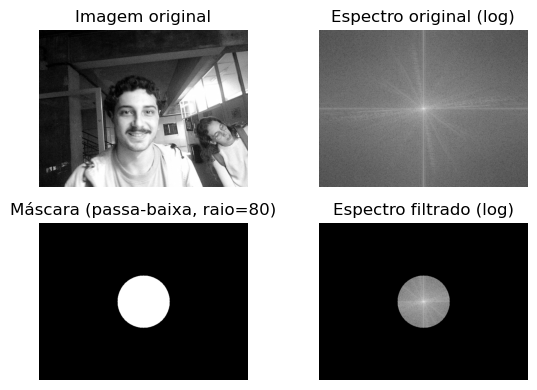

foto_10.jpg filtrada com lpf e salva em teste_lpf\foto_10.jpg


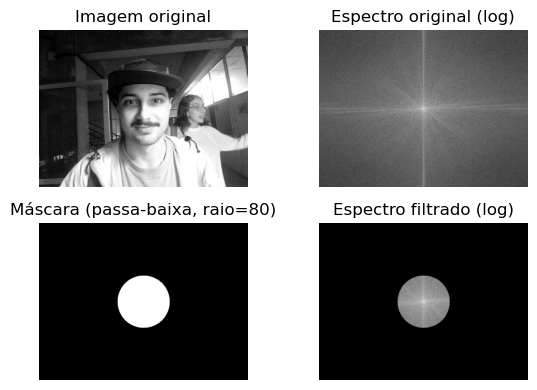

foto_2.jpg filtrada com lpf e salva em teste_lpf\foto_2.jpg


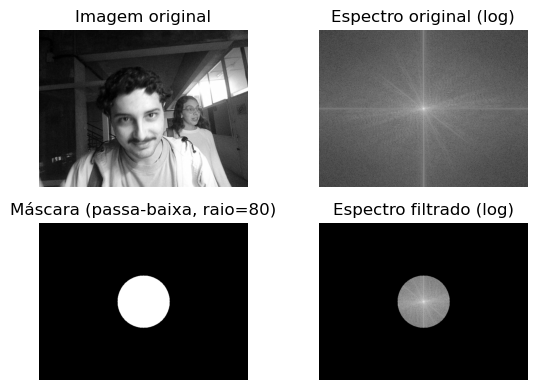

foto_3.jpg filtrada com lpf e salva em teste_lpf\foto_3.jpg


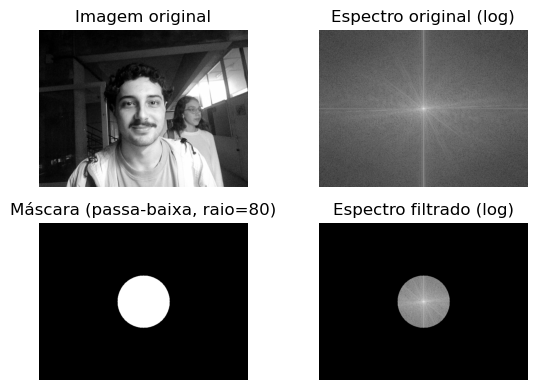

foto_4.jpg filtrada com lpf e salva em teste_lpf\foto_4.jpg


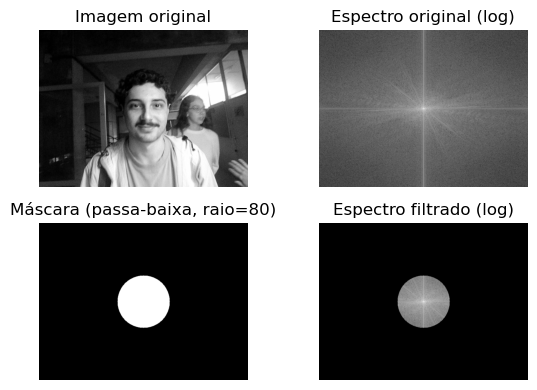

foto_5.jpg filtrada com lpf e salva em teste_lpf\foto_5.jpg


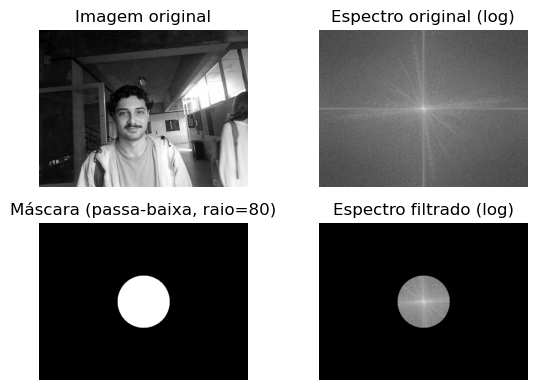

foto_6.jpg filtrada com lpf e salva em teste_lpf\foto_6.jpg


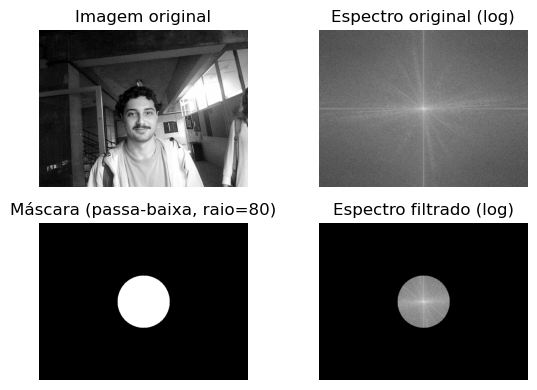

foto_7.jpg filtrada com lpf e salva em teste_lpf\foto_7.jpg


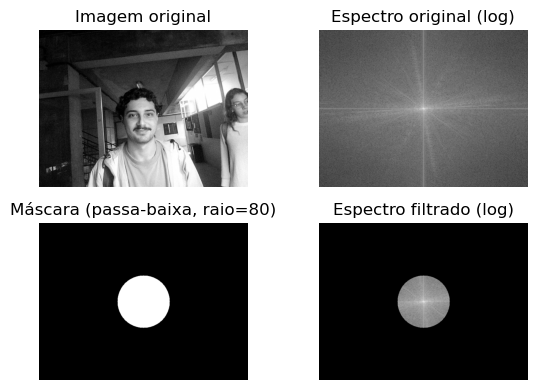

foto_8.jpg filtrada com lpf e salva em teste_lpf\foto_8.jpg


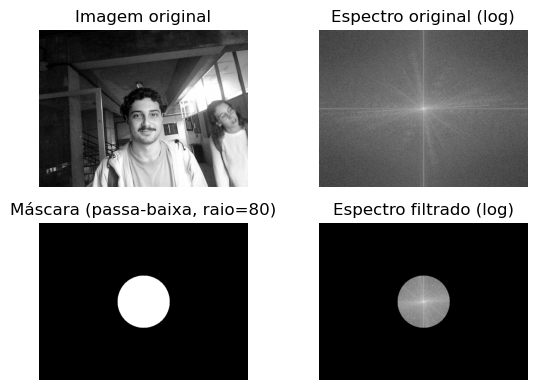

foto_9.jpg filtrada com lpf e salva em teste_lpf\foto_9.jpg


In [64]:
pasta_entrada = 'teste_cinza'
pasta_saida = 'teste_lpf'
os.makedirs(pasta_saida, exist_ok=True)

# Loop nas imagens
for arquivo in os.listdir(pasta_entrada):
    if arquivo.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        caminho_imagem = os.path.join(pasta_entrada, arquivo)
        img = cv2.imread(caminho_imagem, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Erro ao abrir {arquivo}, pulando.")
            continue
        raio = 80 #meio termo
        img_filtrada = low_pass_filter(img, raio=raio)

        # Salvar imagem processada
        caminho_saida = os.path.join(pasta_saida, arquivo)
        cv2.imwrite(caminho_saida, img_filtrada)
        print(f"{arquivo} filtrada com lpf e salva em {caminho_saida}")

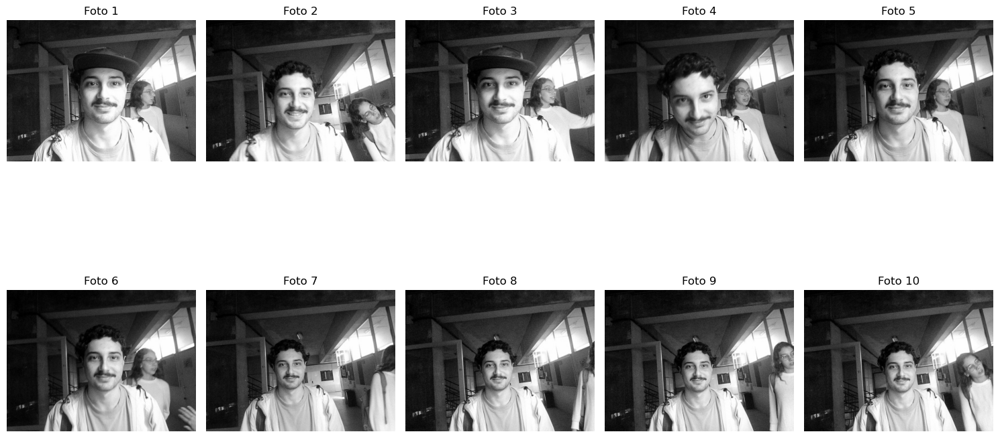

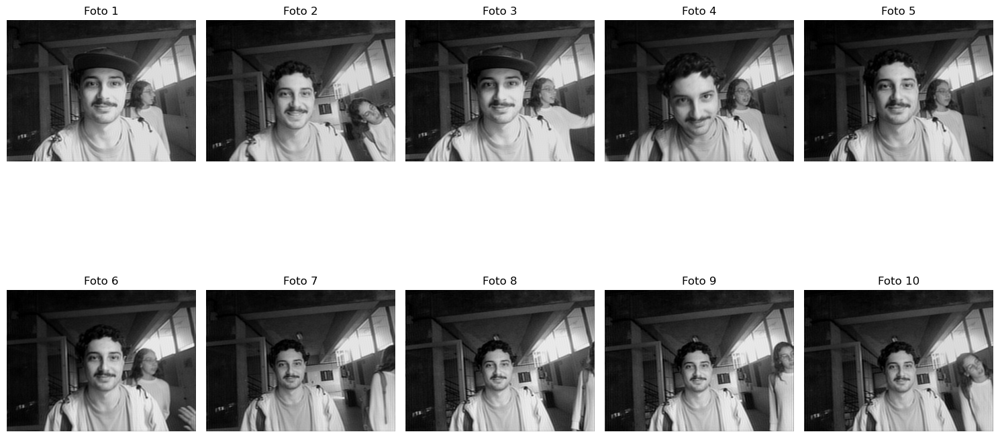

In [65]:
plotar_fotos("teste_cinza")
plotar_fotos("teste_lpf")

# Conclusões e discussões

Nesse benchmarking de pré-processamento foram avaliadas 3 técnicas para melhoria de iluminação e contraste e 3 técnicas de melhoria de ruído. Em relação a melhoria de iluminação, pareceu ser uma boa ideia unir em casacata a técnica de correção gamma e a equalização de histograma local. A equalização de histograma global acabou gerando muitos ruídos ao recalcular a distribuição de histogramas. É claro que teremos menos presença de ruídos quando formos fazer o algoritmo de reconhecimento facial uma vez que estaremos trabalhando apenas com a ROI que nesse caso seria um recorte da face detectada.

Em relação a diminuição de ruídos, percebeu-se que não fazia tanto sentido operar com nenhuma das técnicas, uma vez que a webcam utilizada não possuia muito ruído de aquisição e nem de movimento nas fotos. Assim, visando diminuir o custo computacional, serão utilizadas apenas as técnicas de melhoria de iluminação, utilizando a correção gamma e a equalização de histograma local.

In [78]:
import shutil

# Caminho onde estão suas pastas NEGx_TEMPO
base_dir = r'C:\Users\meier\OneDrive\Documentos\Graduação\Projeto de proc imagens'  # <-- Altere isso
nova_pasta = os.path.join(base_dir, 'TODOS_NEGATIVOS')

# Cria a nova pasta se não existir
os.makedirs(nova_pasta, exist_ok=True)

# Percorre todas as pastas no diretório base
for nome_pasta in os.listdir(base_dir):
    caminho_pasta = os.path.join(base_dir, nome_pasta)

    # Verifica se é uma pasta e se começa com 'NEG'
    if os.path.isdir(caminho_pasta) and nome_pasta.startswith('NEG'):
        for nome_arquivo in os.listdir(caminho_pasta):
            caminho_arquivo = os.path.join(caminho_pasta, nome_arquivo)

            # Garante que é um arquivo (imagem)
            if os.path.isfile(caminho_arquivo):
                # Gera um novo nome único para evitar conflitos (opcional)
                novo_nome = f"{nome_pasta}_{nome_arquivo}"
                destino = os.path.join(nova_pasta, novo_nome)
                shutil.copy2(caminho_arquivo, destino)

print("Cópia concluída para a pasta TODOS_NEGATIVOS.")


Cópia concluída para a pasta TODOS_NEGATIVOS.
